# Customer Segmentation using Machine Learning

Using statistical analysis and machine learning through clustering, this model is used to segment customerson the basis of LRFM features as per following categories for the customers:

**"Long-Time Frequent Buyers",**

**"Balanced Loyalists",**

**"Cost-Conscious Product Buyers",**

**"Occasional Buyers",**

**"Continuously Moderate Spenders",**

**"Currently Lost High-Value Customers",**

**"Offer loving Cost-Conscious Veterans",**

**"Less Interested Consumers",**

**"Moderately Involved High Spending Veterans",**

**"Irregular yet Frequent VIPs",**

**"Cost-Conscious Constant Buyers",**

**"Losing Long-Time High Spenders",**

**"Momentary but Multiple Products Buyers",**

**"Deal Seeking Customers",**

**"Emerging Cost-Conscious Loyalists",**

**"Semi-Premium Customers",**

**"Elite/Perfect Customers",**

**"Weekly Overspending Veterans",**

**"Irregular & Moderate Buyers",**

**"Least Interested Customers"**

The model also predicts certain 180 days' sales' prediction based on previous 180 days' sales' prediction.

###### First up, all the necessary imports have been made.

In [1]:
from datetime import datetime
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D
import plotly.express as px
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import DBSCAN
from sklearn.mixture import GaussianMixture
from sklearn.cluster import KMeans
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import MeanShift
from sklearn.cluster import AffinityPropagation
from sklearn.cluster import OPTICS
from sklearn.cluster import SpectralClustering
from sklearn.cluster import Birch
from sklearn.preprocessing import MinMaxScaler
import plotly.express as px
from bokeh.plotting import figure, show
from bokeh.models import ColumnDataSource
import os
from sklearn.preprocessing import LabelEncoder
from matplotlib.colors import ListedColormap
import plotly.graph_objects as go
import plotnine as pn
from plotnine import ggplot, aes, geom_line, geom_point, facet_wrap, scale_x_date, theme, scale_x_continuous, geom_col, coord_flip
from xgboost import XGBClassifier 
from xgboost import XGBRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score

# Dataset Import 

First up, I have a dataset of particular amount of customers who more often than not purchase in Amazon. Let's study the dataset 

#### Importing the dataset from local device

read_csv("C:/Users/Dell/Downloads/sales_data.csv" to import from pc.
Hasn't been mounted to drive as yet.

Firstly, changing the datatype of _CustomerID_ to str

In [2]:
data_type = {
    '_CustomerID':str
}

In [3]:
sales_data = pd.read_csv("C:/Users/Dell/Downloads/sales_data.csv", dtype = data_type, parse_dates = ['OrderDate'])
sales_data

,OrderNumber,Sales Channel,WarehouseCode,ProcuredDate,OrderDate,ShipDate,DeliveryDate,CurrencyCode,_SalesTeamID,_CustomerID,_StoreID,_ProductID,Order Quantity,Discount Applied,Unit Price,Unit Cost
0,SO - 000101,In-Store,WARE-UHY1004,12/31/2017,2018-05-31,6/14/2018,6/19/2018,USD,6,15,259,12,5,0.075,1963.1,1001.181
1,SO - 000102,Online,WARE-NMK1003,12/31/2017,2018-05-31,6/22/2018,7/2/2018,USD,14,20,196,27,3,0.075,3939.6,3348.660
2,SO - 000103,Distributor,WARE-UHY1004,12/31/2017,2018-05-31,6/21/2018,7/1/2018,USD,21,16,213,16,1,0.050,1775.5,781.220
3,SO - 000104,Wholesale,WARE-NMK1003,12/31/2017,2018-05-31,6/2/2018,6/7/2018,USD,28,48,107,23,8,0.075,2324.9,1464.687
4,SO - 000105,Distributor,WARE-NMK1003,4/10/2018,2018-05-31,6/16/2018,6/26/2018,USD,22,49,111,26,8,0.100,1822.4,1476.144
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7986,SO - 0008087,In-Store,WARE-MKL1006,9/26/2020,2020-12-30,1/7/2021,1/14/2021,USD,9,41,339,29,1,0.075,234.5,121.940
7987,SO - 0008088,Online,WARE-NMK1003,9/26/2020,2020-12-30,1/2/2021,1/4/2021,USD,14,29,202,3,6,0.050,3202.6,1921.560
7988,SO - 0008089,Online,WARE-UHY1004,9/26/2020,2020-12-30,1/23/2021,1/26/2021,USD,14,32,241,35,5,0.200,3825.7,2792.761
7989,SO - 0008090,Online,WARE-NMK1003,9/26/2020,2020-12-30,1/20/2021,1/25/2021,USD,20,42,112,36,8,0.100,1072.0,804.000


In [4]:
sales_data['_CustomerID'].unique()

array(['15', '20', '16', '48', '49', '21', '14', '9', '33', '36', '17',
       '32', '11', '10', '30', '5', '23', '46', '40', '19', '22', '29',
       '35', '42', '2', '28', '34', '26', '24', '18', '3', '13', '4',
       '25', '8', '47', '6', '38', '1', '7', '27', '44', '12', '50', '43',
       '37', '41', '31', '45', '39'], dtype=object)

**From the above dataset named sales_data what we can see is that there are 7991 entries but the total number of customers are way too less.**

So, this dataset contains all the transaction records off all those customers over a certain amount of time.

Now, let's study the first 5 records of the dataset.
There are a number of columns and well they can be used to calculate LRFM features and also the predicted spend such as **OrderDate, OrderNumber, _CustomerID_, Order Quantity, Discount Applied, Unit Price, Unit Cost**

In [5]:
sales_data.head()

,OrderNumber,Sales Channel,WarehouseCode,ProcuredDate,OrderDate,ShipDate,DeliveryDate,CurrencyCode,_SalesTeamID,_CustomerID,_StoreID,_ProductID,Order Quantity,Discount Applied,Unit Price,Unit Cost
0,SO - 000101,In-Store,WARE-UHY1004,12/31/2017,2018-05-31,6/14/2018,6/19/2018,USD,6,15,259,12,5,0.075,1963.1,1001.181
1,SO - 000102,Online,WARE-NMK1003,12/31/2017,2018-05-31,6/22/2018,7/2/2018,USD,14,20,196,27,3,0.075,3939.6,3348.660
2,SO - 000103,Distributor,WARE-UHY1004,12/31/2017,2018-05-31,6/21/2018,7/1/2018,USD,21,16,213,16,1,0.050,1775.5,781.220
3,SO - 000104,Wholesale,WARE-NMK1003,12/31/2017,2018-05-31,6/2/2018,6/7/2018,USD,28,48,107,23,8,0.075,2324.9,1464.687
4,SO - 000105,Distributor,WARE-NMK1003,4/10/2018,2018-05-31,6/16/2018,6/26/2018,USD,22,49,111,26,8,0.100,1822.4,1476.144


<Axes: xlabel='OrderDate'>

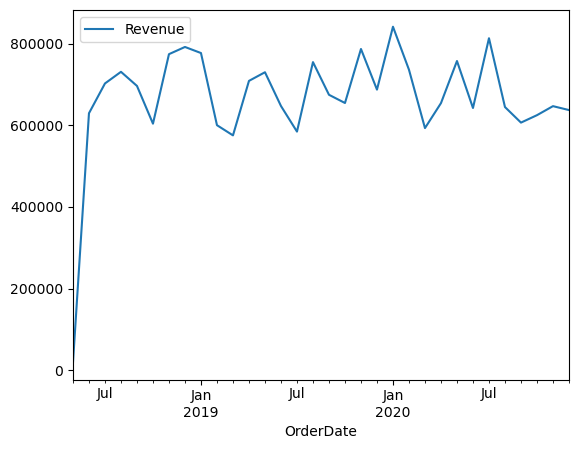

In [6]:
sales_data['Revenue'] = (sales_data['Unit Price'] - (sales_data['Unit Price'] * sales_data['Discount Applied']) - sales_data ['Unit Cost']) * sales_data['Order Quantity']

# Calculate mean revenue for each customer
mean_revenue = sales_data.groupby('_CustomerID')['Revenue'].transform('mean')

# Create a new column 'MeanRevenue' in cutoff_in DataFrame
sales_data['MeanRevenue'] = mean_revenue

sales_data1 = (
    sales_data
    .reset_index()
    .set_index('OrderDate')
    [['Revenue']]
    .resample('MS')
    .sum()
)

sales_data1.plot()

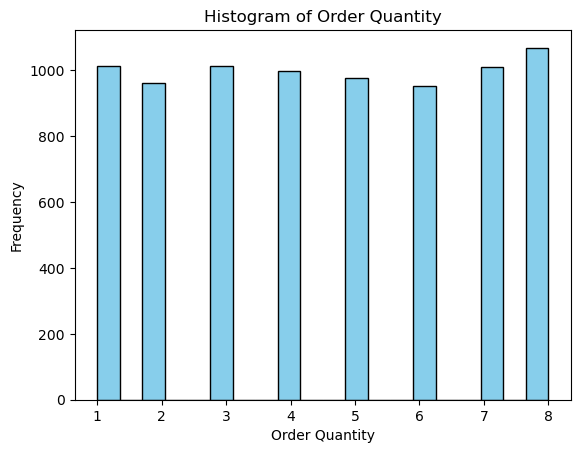

In [7]:
plt.hist(sales_data['Order Quantity'], bins=20, color='skyblue', edgecolor='black')
plt.xlabel('Order Quantity')
plt.ylabel('Frequency')
plt.title('Histogram of Order Quantity')
plt.show()

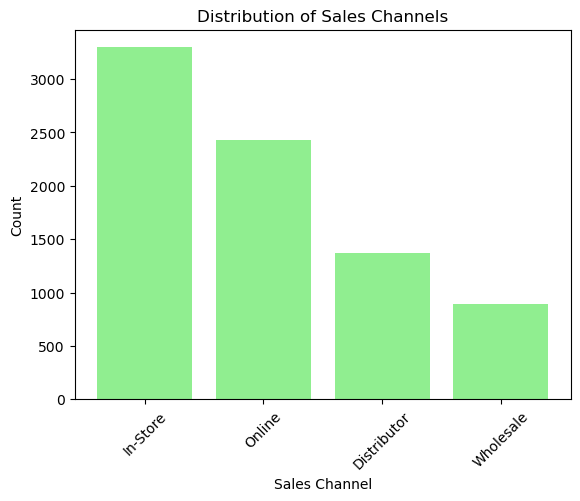

In [8]:
sales_channel_counts = sales_data['Sales Channel'].value_counts()
plt.bar(sales_channel_counts.index, sales_channel_counts.values, color='lightgreen')
plt.xlabel('Sales Channel')
plt.ylabel('Count')
plt.title('Distribution of Sales Channels')
plt.xticks(rotation=45)
plt.show()

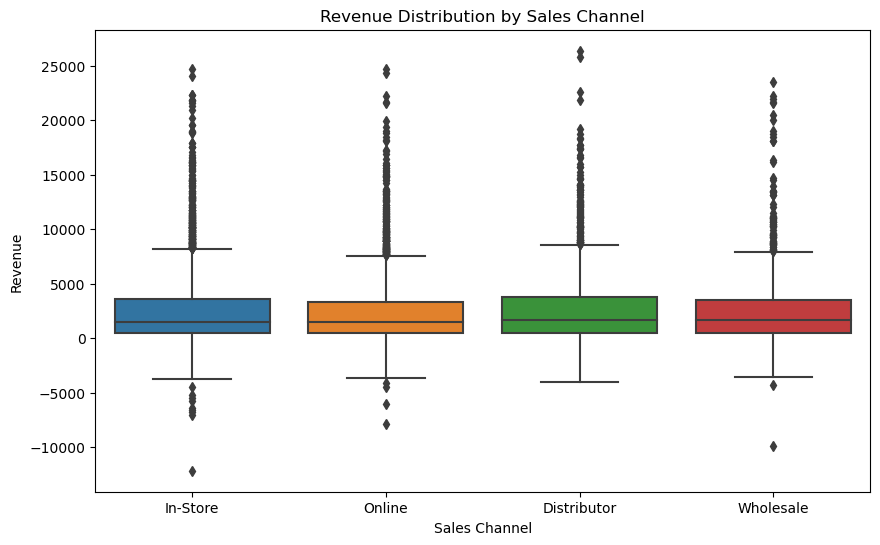

In [9]:
plt.figure(figsize=(10, 6))
sns.boxplot(x='Sales Channel', y='Revenue', data=sales_data)
plt.xlabel('Sales Channel')
plt.ylabel('Revenue')
plt.title('Revenue Distribution by Sales Channel')
plt.show()


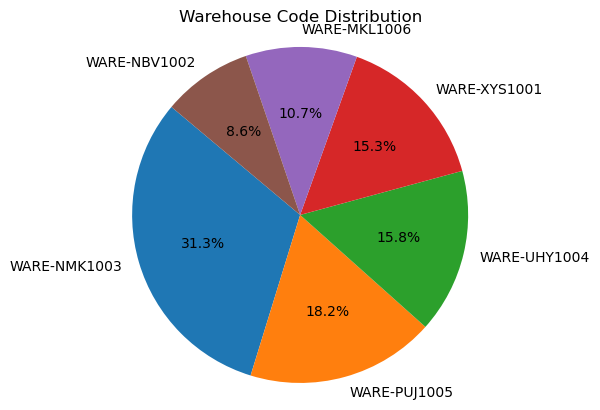

In [10]:
warehouse_counts = sales_data['WarehouseCode'].value_counts()
plt.pie(warehouse_counts.values, labels=warehouse_counts.index, autopct='%1.1f%%', startangle=140)
plt.axis('equal')
plt.title('Warehouse Code Distribution')
plt.show()


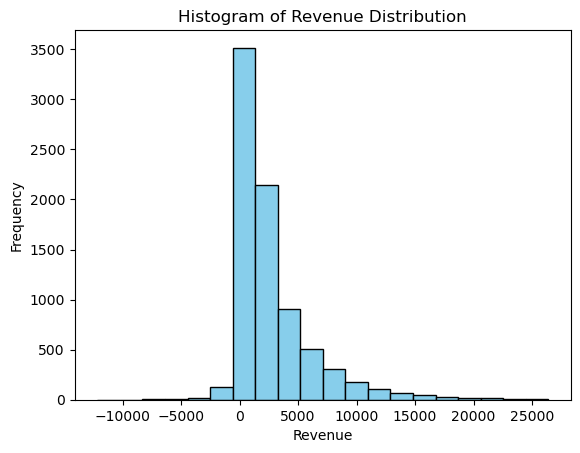

In [11]:
# Plot histogram of revenue distribution
plt.hist(sales_data['Revenue'], bins=20, color='skyblue', edgecolor='black')
plt.xlabel('Revenue')
plt.ylabel('Frequency')
plt.title('Histogram of Revenue Distribution')
plt.show()

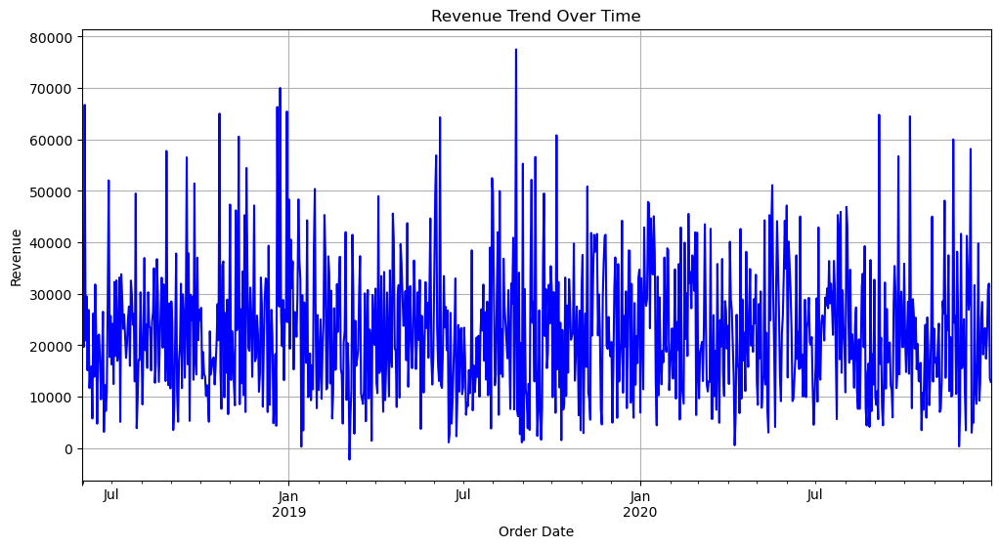

In [15]:
# Group sales data by OrderDate and sum the revenue
revenue_over_time = sales_data.groupby('OrderDate')['Revenue'].sum()

# Plot
plt.figure(figsize=(12, 6))
revenue_over_time.plot(color='blue')
plt.title('Revenue Trend Over Time')
plt.xlabel('Order Date')
plt.ylabel('Revenue')
plt.grid(True)
plt.show()

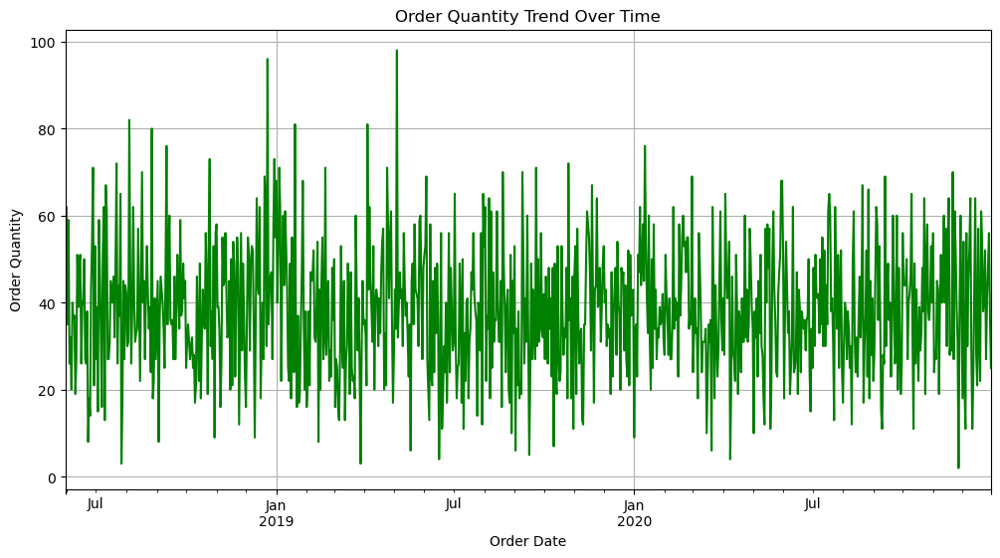

In [16]:
# Group sales data by OrderDate and sum the order quantity
order_quantity_over_time = sales_data.groupby('OrderDate')['Order Quantity'].sum()

# Plot
plt.figure(figsize=(12, 6))
order_quantity_over_time.plot(color='green')
plt.title('Order Quantity Trend Over Time')
plt.xlabel('Order Date')
plt.ylabel('Order Quantity')
plt.grid(True)
plt.show()


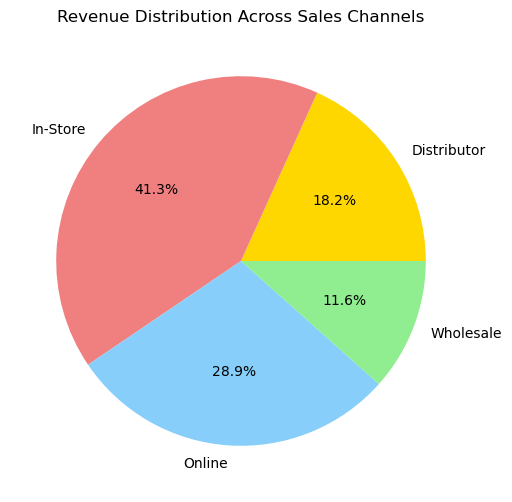

In [19]:
# Calculate total revenue for each sales channel
revenue_by_channel = sales_data.groupby('Sales Channel')['Revenue'].sum()

# Plot
plt.figure(figsize=(8, 6))
revenue_by_channel.plot(kind='pie', autopct='%1.1f%%', colors=['gold', 'lightcoral', 'lightskyblue', 'lightgreen'])
plt.title('Revenue Distribution Across Sales Channels')
plt.ylabel('')
plt.show()

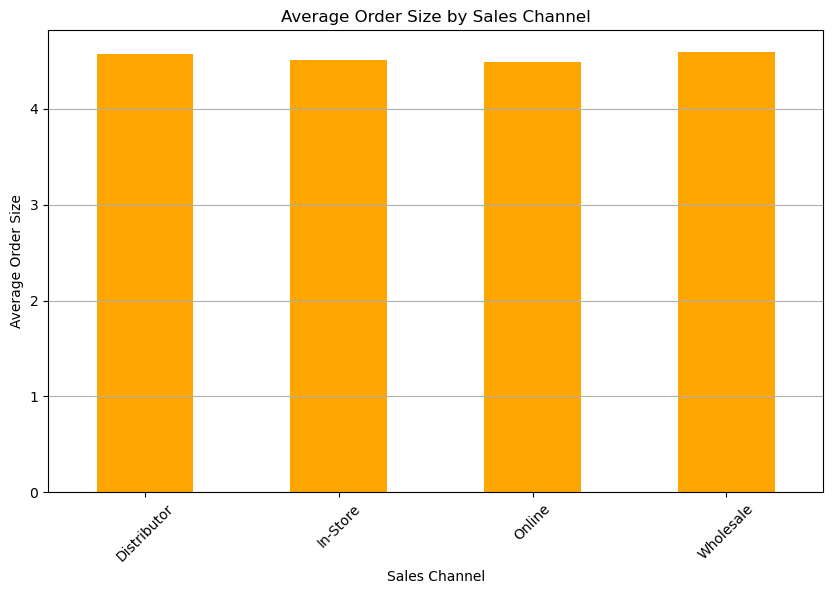

In [20]:
# Calculate the average order size for each sales channel
average_order_size_by_channel = sales_data.groupby('Sales Channel')['Order Quantity'].mean()

# Plot
plt.figure(figsize=(10, 6))
average_order_size_by_channel.plot(kind='bar', color='orange')
plt.title('Average Order Size by Sales Channel')
plt.xlabel('Sales Channel')
plt.ylabel('Average Order Size')
plt.xticks(rotation=45)
plt.grid(axis='y')
plt.show()

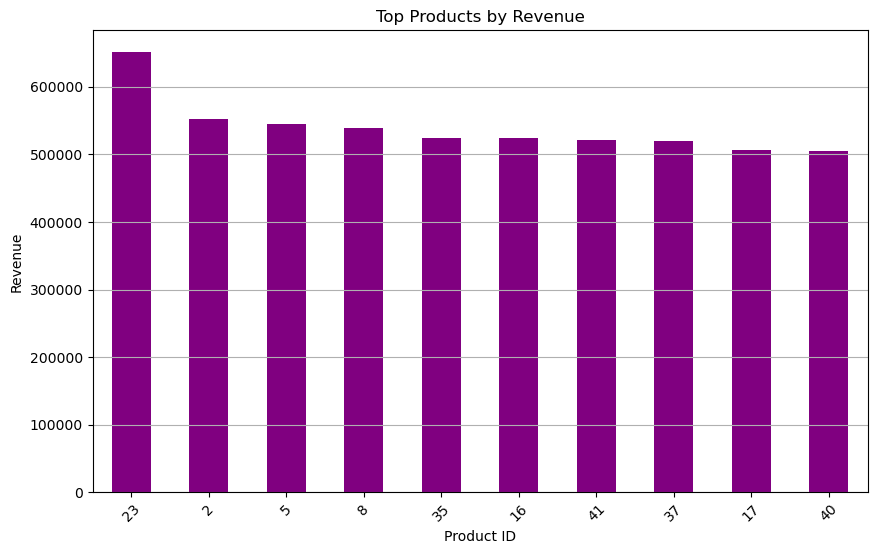

In [21]:
# Calculate total revenue for each product
revenue_by_product = sales_data.groupby('_ProductID')['Revenue'].sum().nlargest(10)

# Plot
plt.figure(figsize=(10, 6))
revenue_by_product.plot(kind='bar', color='purple')
plt.title('Top Products by Revenue')
plt.xlabel('Product ID')
plt.ylabel('Revenue')
plt.xticks(rotation=45)
plt.grid(axis='y')
plt.show()


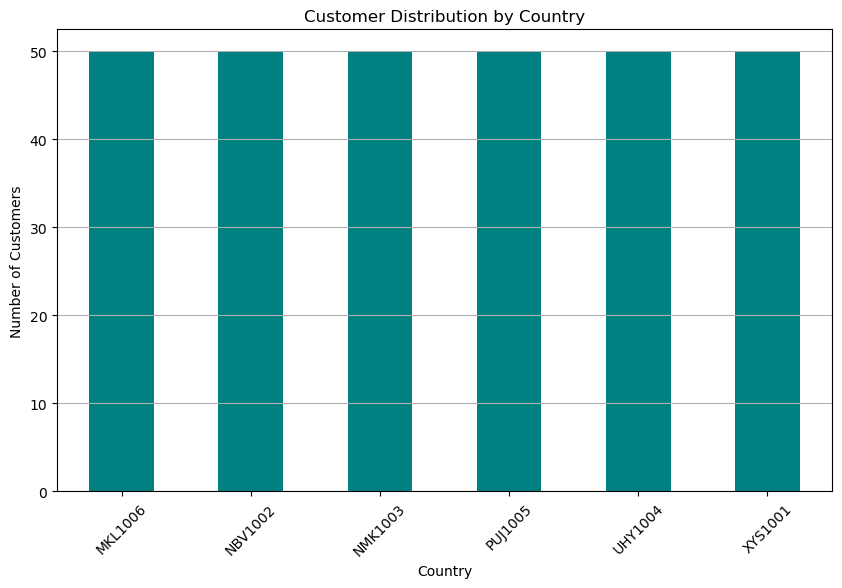

In [22]:
# Extract country from the WarehouseCode
sales_data['Country'] = sales_data['WarehouseCode'].str.split('-').str[1]

# Count the number of unique customers in each country
customer_distribution_by_country = sales_data.groupby('Country')['_CustomerID'].nunique().nlargest(10)

# Plot
plt.figure(figsize=(10, 6))
customer_distribution_by_country.plot(kind='bar', color='teal')
plt.title('Customer Distribution by Country')
plt.xlabel('Country')
plt.ylabel('Number of Customers')
plt.xticks(rotation=45)
plt.grid(axis='y')
plt.show()


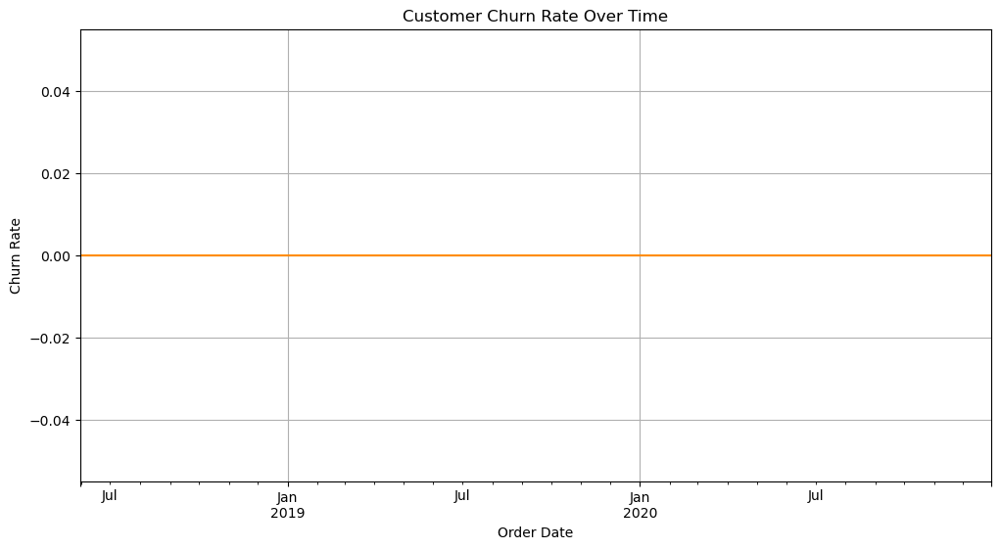

In [23]:
# Calculate churn rate over time
churn_rate_over_time = sales_data.groupby('OrderDate').apply(lambda x: 1 - x['_CustomerID'].nunique() / x['_CustomerID'].nunique())

# Plot
plt.figure(figsize=(12, 6))
churn_rate_over_time.plot(color='darkorange')
plt.title('Customer Churn Rate Over Time')
plt.xlabel('Order Date')
plt.ylabel('Churn Rate')
plt.grid(True)
plt.show()


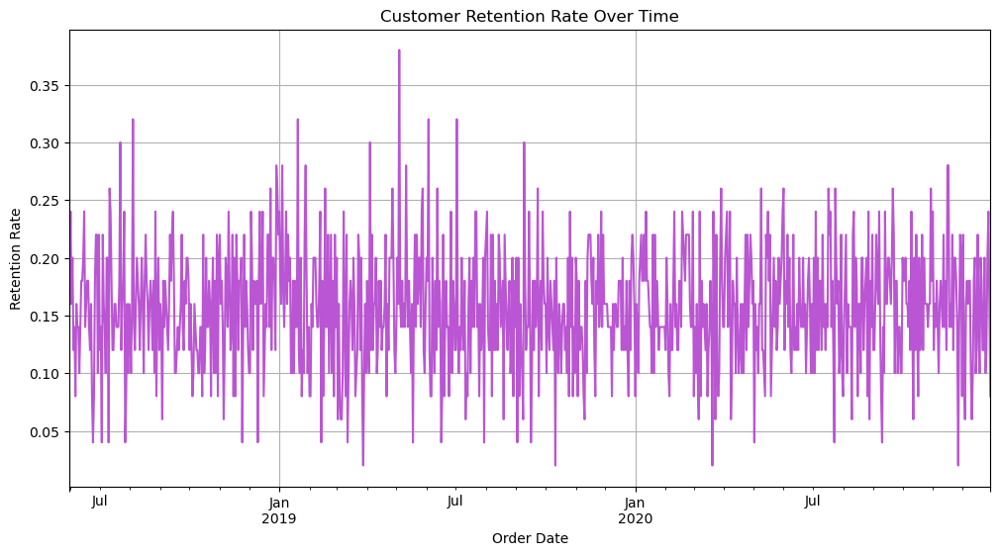

In [27]:
# Calculate retention rate over time
retention_rate_over_time = sales_data.groupby('OrderDate').apply(lambda x: x['_CustomerID'].nunique() / sales_data['_CustomerID'].nunique())

# Plot
plt.figure(figsize=(12, 6))
retention_rate_over_time.plot(color='mediumorchid')
plt.title('Customer Retention Rate Over Time')
plt.xlabel('Order Date')
plt.ylabel('Retention Rate')
plt.grid(True)
plt.show()


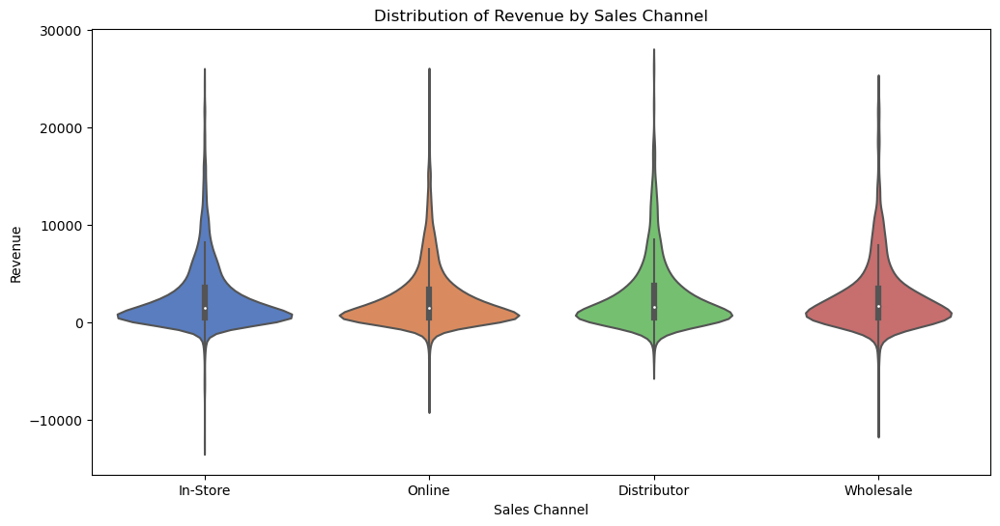

In [28]:
plt.figure(figsize=(12, 6))
sns.violinplot(x='Sales Channel', y='Revenue', data=sales_data, palette='muted')
plt.title('Distribution of Revenue by Sales Channel')
plt.xlabel('Sales Channel')
plt.ylabel('Revenue')
plt.show()


<Figure size 1200x600 with 0 Axes>

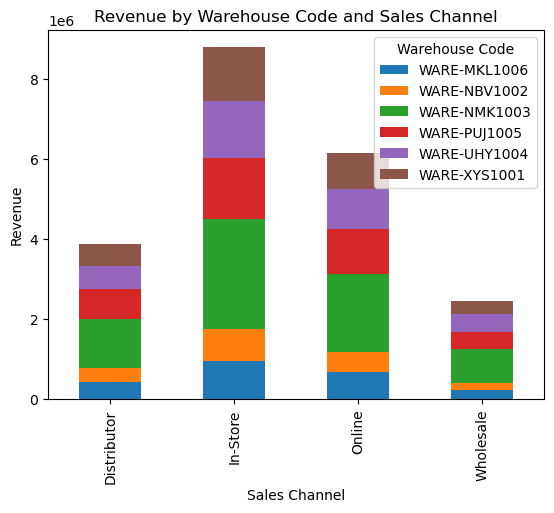

In [29]:
plt.figure(figsize=(12, 6))
sales_data.pivot_table(index='Sales Channel', columns='WarehouseCode', values='Revenue', aggfunc='sum').plot(kind='bar', stacked=True)
plt.title('Revenue by Warehouse Code and Sales Channel')
plt.xlabel('Sales Channel')
plt.ylabel('Revenue')
plt.legend(title='Warehouse Code')
plt.show()


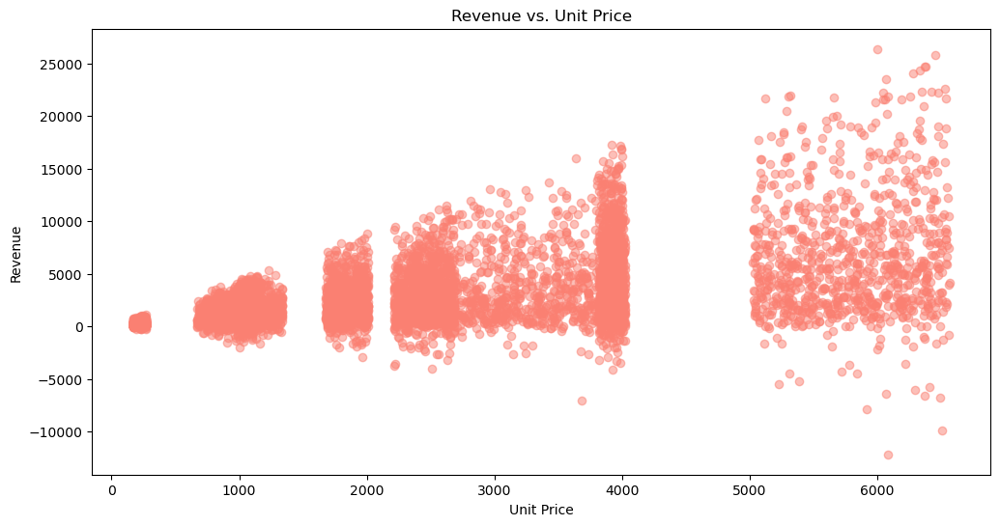

In [30]:
plt.figure(figsize=(12, 6))
plt.scatter(sales_data['Unit Price'], sales_data['Revenue'], color='salmon', alpha=0.5)
plt.title('Revenue vs. Unit Price')
plt.xlabel('Unit Price')
plt.ylabel('Revenue')
plt.show()


D:\Anaconda\Lib\site-packages\seaborn\axisgrid.py:1507: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
D:\Anaconda\Lib\site-packages\seaborn\axisgrid.py:1507: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
D:\Anaconda\Lib\site-packages\seaborn\axisgrid.py:1507: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
D:\Anaconda\Lib\site-packages\seaborn\axisgrid.py:1609: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
D:\Anaconda\Lib\site-packages\seaborn\axisgrid.py:1609: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
D:\Anaconda\Lib\site-packages\seaborn\axisgrid.py:1609: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
D:\Anaconda\Lib\site-packages\seaborn\axisgrid.py:1609: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
D:\Anaconda\Lib\site-packages\seaborn\axisgrid.py:1609: UserWarning: 

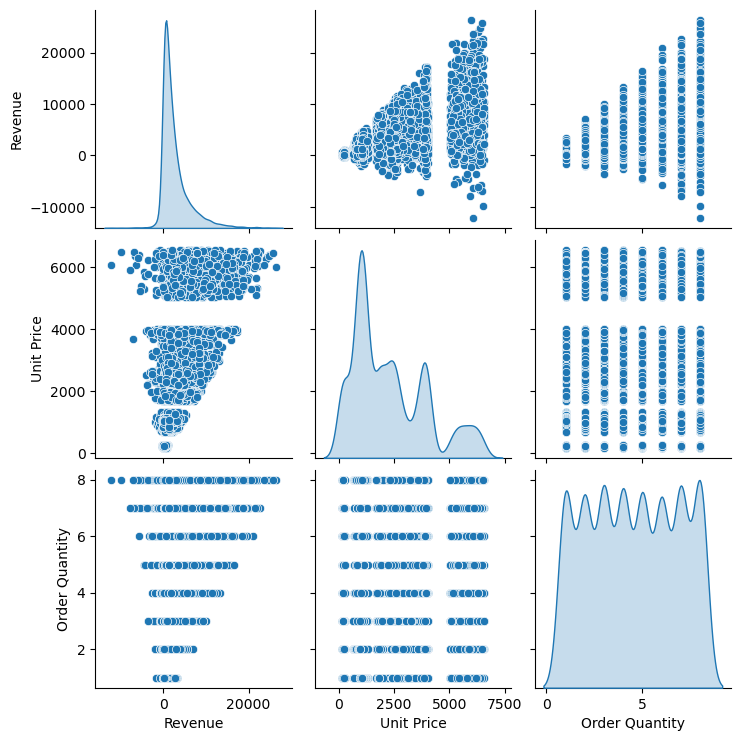

In [32]:
sns.pairplot(sales_data[['Revenue', 'Unit Price', 'Order Quantity']], diag_kind='kde', palette='bright')
plt.show()


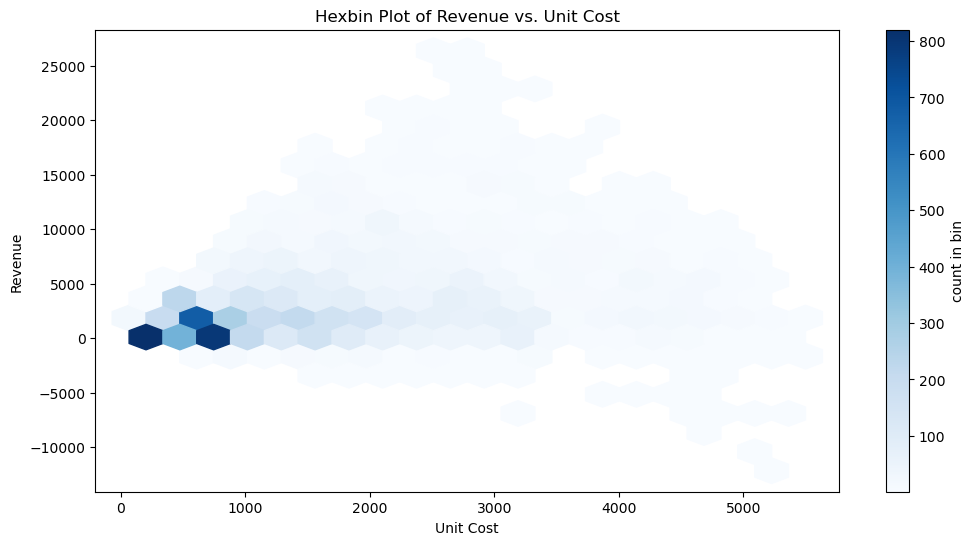

In [33]:
plt.figure(figsize=(12, 6))
plt.hexbin(sales_data['Unit Cost'], sales_data['Revenue'], gridsize=20, cmap='Blues', mincnt=1)
plt.colorbar(label='count in bin')
plt.title('Hexbin Plot of Revenue vs. Unit Cost')
plt.xlabel('Unit Cost')
plt.ylabel('Revenue')
plt.show()


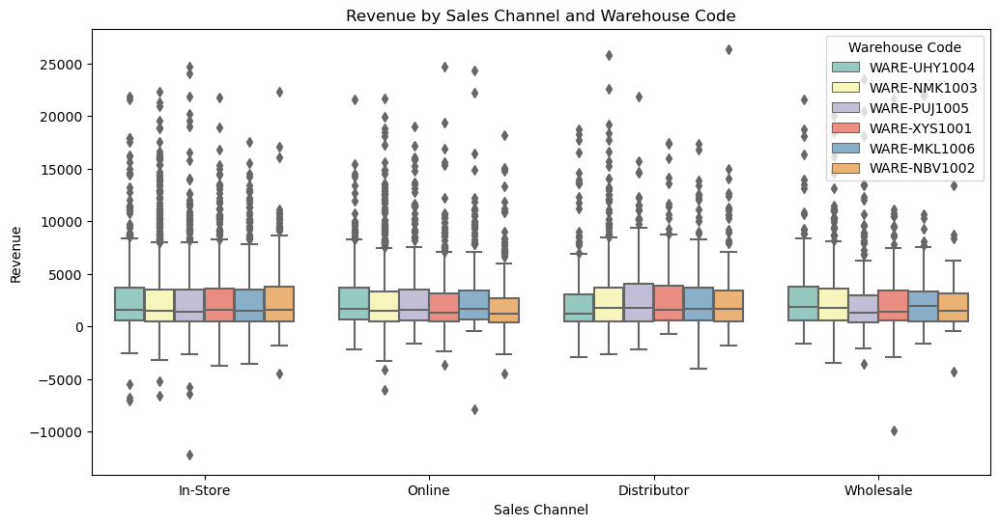

In [34]:
plt.figure(figsize=(12, 6))
sns.boxplot(x='Sales Channel', y='Revenue', hue='WarehouseCode', data=sales_data, palette='Set3')
plt.title('Revenue by Sales Channel and Warehouse Code')
plt.xlabel('Sales Channel')
plt.ylabel('Revenue')
plt.legend(title='Warehouse Code')
plt.show()


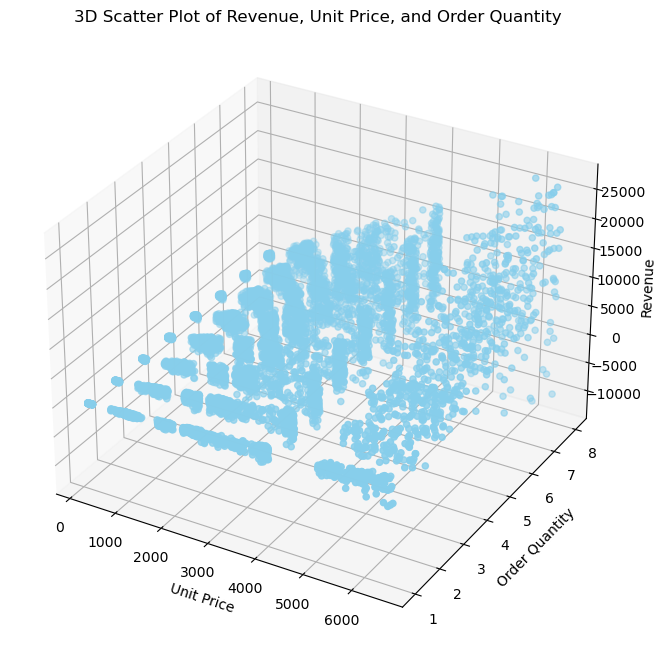

In [37]:
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(sales_data['Unit Price'], sales_data['Order Quantity'], sales_data['Revenue'], c='skyblue', marker='o')
ax.set_xlabel('Unit Price')
ax.set_ylabel('Order Quantity')
ax.set_zlabel('Revenue')
plt.title('3D Scatter Plot of Revenue, Unit Price, and Order Quantity')
plt.show()


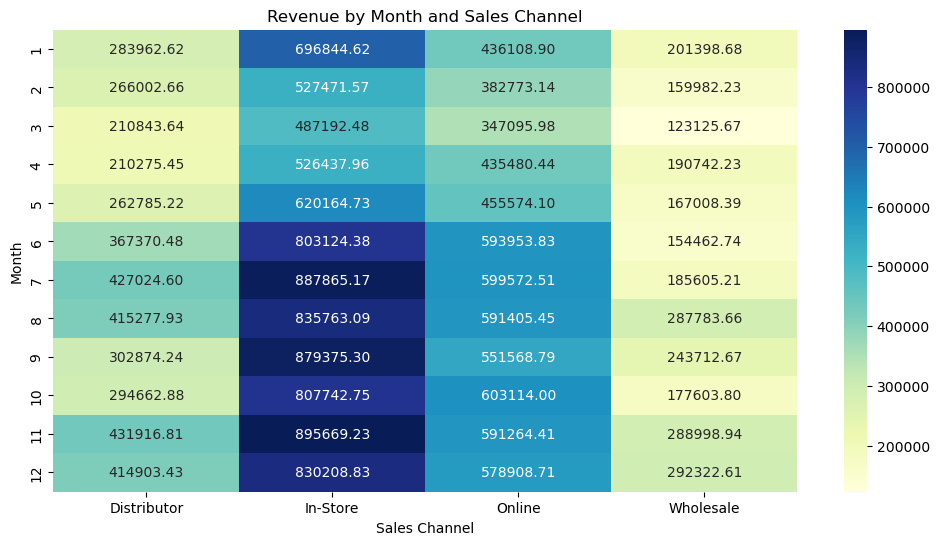

In [38]:
# Extract month from OrderDate
sales_data['Month'] = sales_data['OrderDate'].dt.month

# Create a pivot table for heatmap
heatmap_data = sales_data.pivot_table(index='Month', columns='Sales Channel', values='Revenue', aggfunc='sum')

# Plot heatmap
plt.figure(figsize=(12, 6))
sns.heatmap(heatmap_data, cmap='YlGnBu', annot=True, fmt=".2f")
plt.title('Revenue by Month and Sales Channel')
plt.xlabel('Sales Channel')
plt.ylabel('Month')
plt.show()

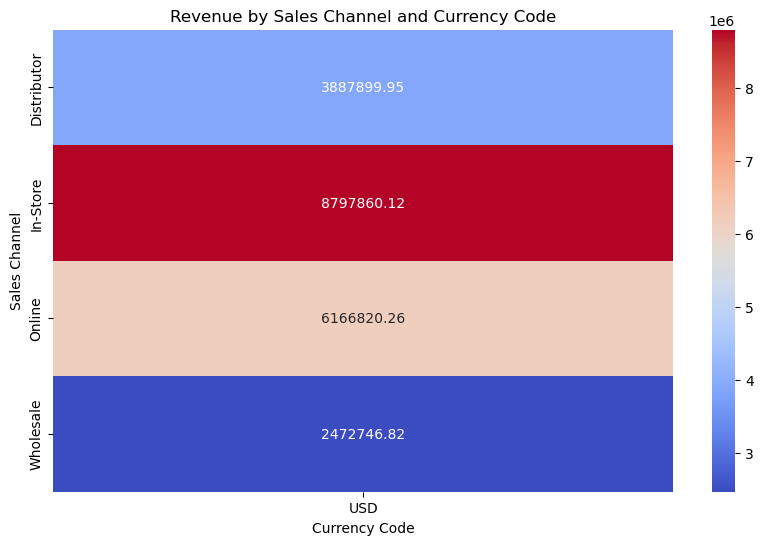

In [39]:
# Create a pivot table for heatmap
heatmap_data = sales_data.pivot_table(index='Sales Channel', columns='CurrencyCode', values='Revenue', aggfunc='sum')

# Plot heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(heatmap_data, cmap='coolwarm', annot=True, fmt=".2f")
plt.title('Revenue by Sales Channel and Currency Code')
plt.xlabel('Currency Code')
plt.ylabel('Sales Channel')
plt.show()

**CREATING REVENUE COLUMN FOR MONETARY FEATURE** 

using the formula sales_data['Revenue'] = (sales_data['Unit Price'] - (sales_data['Unit Price'] * sales_data['Discount Applied']) - sales_data ['Unit Cost']) * sales_data['Order Quantity']

**Also, calculation of the mean money spent by each customer has been calculated for predicted money spent as it is a regression problem and we need mean money spent for regression problems.**

#### Plotting a graph to check the impact to the business from the given customers

The graph shows how inconsistent the transactions of the given customers with respect to Amazon has been. In order to solve the inconsistentency and the recent decline in the business, this cutomer segmenattaion is being done.

### Data Pre-Processing and Cleaning (if necessary)

**No null Values**

**OrderDate converted to datetime during import**

**Need to process data in the manner LRFM demands**

In [7]:
df = sales_data.copy()
df['OrderDate'].isnull().sum()
# df['OrderDate'].max()

0

In [8]:
df.dtypes

OrderNumber                 object
Sales Channel               object
WarehouseCode               object
ProcuredDate                object
OrderDate           datetime64[ns]
ShipDate                    object
DeliveryDate                object
CurrencyCode                object
_SalesTeamID                 int64
_CustomerID                 object
_StoreID                     int64
_ProductID                   int64
Order Quantity               int64
Discount Applied           float64
Unit Price                 float64
Unit Cost                  float64
Revenue                    float64
MeanRevenue                float64
dtype: object

#### Making a new dataset df_dataset containing the necessary colums from sales data for LRFM features and prediction features

_'OrderNumber', 'CustomerID', 'OrderDate', 'Revenue', 'MeanRevenue'_

In [9]:
columns = ['OrderNumber', '_CustomerID', 'OrderDate', 'Revenue', 'MeanRevenue']
df_dataset = df[columns]

df_dataset

,OrderNumber,_CustomerID,OrderDate,Revenue,MeanRevenue
0,SO - 000101,15,2018-05-31,4073.4325,3110.340528
1,SO - 000102,20,2018-05-31,886.4100,2629.628437
2,SO - 000103,16,2018-05-31,905.5050,2984.731633
3,SO - 000104,48,2018-05-31,5486.7640,2470.760169
4,SO - 000105,49,2018-05-31,1312.1280,2330.008750
...,...,...,...,...,...
7986,SO - 0008087,41,2020-12-30,94.9725,2507.411745
7987,SO - 0008088,29,2020-12-30,6725.4600,2970.785989
7988,SO - 0008089,32,2020-12-30,1338.9950,2515.642029
7989,SO - 0008090,42,2020-12-30,1286.4000,2653.165252


In [10]:
n_days = 180
max_date = df_dataset['OrderDate'].max()
cutoff = max_date - pd.to_timedelta(n_days, unit="d")
cutoff1 = cutoff - pd.to_timedelta(n_days, unit="d")


cutoff_in = df_dataset[df_dataset['OrderDate'] <= cutoff].copy()
cutoff_out = df_dataset[df_dataset['OrderDate'] > cutoff]
cutoff_in1 = df_dataset[(df_dataset['OrderDate'] <= cutoff) & (df_dataset['OrderDate'] > cutoff1)]

# Display cutoff_in DataFrame
cutoff_in1

,OrderNumber,_CustomerID,OrderDate,Revenue,MeanRevenue
4904,SO - 0005005,50,2020-01-06,1437.150,3057.576650
4905,SO - 0005006,9,2020-01-06,895.455,2924.950041
4906,SO - 0005007,46,2020-01-06,269.608,2410.284885
4907,SO - 0005008,38,2020-01-06,-102.108,2337.917653
4908,SO - 0005009,15,2020-01-06,742.896,3110.340528
...,...,...,...,...,...
6437,SO - 0006538,19,2020-07-03,538.412,2686.253536
6438,SO - 0006539,7,2020-07-03,423.574,2706.901814
6439,SO - 0006540,18,2020-07-03,1418.524,2428.159968
6440,SO - 0006541,18,2020-07-03,2934.064,2428.159968


In [11]:
# Assuming targets_df is defined
targets_df = cutoff_out.groupby('_CustomerID')['Revenue'].sum().reset_index()\
    .rename(columns={'Revenue': 'Spent_last_30'})\
    .assign(Spent_last_30_flag=1)

# Set '_CustomerID' as the index
targets_df.set_index('_CustomerID', inplace=True)

# Display targets_df
targets_df

,Spent_last_30,Spent_last_30_flag
_CustomerID,,
1,27930.8595,1
10,98415.2280,1
11,103724.3750,1
12,127688.5665,1
13,90949.0495,1
14,93484.0280,1
15,109837.4550,1
16,79482.8035,1
17,63041.2380,1


In [12]:
features_df = cutoff_in.groupby('_CustomerID').agg({
    'OrderDate' : lambda v: (cutoff_in['OrderDate'].max() + pd.Timedelta(days=1) - v.max()).days,
    'OrderNumber' : 'count',
    'Revenue' : 'sum',
    'MeanRevenue' : 'first'
})
features_df1 = cutoff_in1.groupby('_CustomerID').agg({
    'OrderDate' : lambda v: (cutoff_in['OrderDate'].max() + pd.Timedelta(days=1) - v.max()).days,
    'OrderNumber' : 'count',
    'Revenue' : 'sum',
    'MeanRevenue' : 'first'
})
features_df1


,OrderDate,OrderNumber,Revenue,MeanRevenue
_CustomerID,,,,
1,8,36,94401.5260,2210.089549
10,1,31,68190.4895,2753.937892
11,5,34,95288.6730,2739.405851
12,4,52,176050.7410,2936.758357
13,3,22,66252.5145,2578.966547
14,4,27,47071.5200,2429.618013
15,31,32,115080.7410,3110.340528
16,14,24,71293.9965,2984.731633
17,2,35,114526.7850,3051.585063


In [13]:
features_df.rename(
    columns= {
        'OrderDate' : 'Recency_before_last_30_days',
        'OrderNumber' : 'Frequency_before_last_30_days',
        'Revenue' : 'Monetary_before_last_30_days',
        'MeanRevenue' : 'Average_Money_before_last_30_days'
    },
    inplace=True
)
features_df1.rename(
    columns= {
        'OrderDate' : 'Recency_before_180_days_of_cutoff',
        'OrderNumber' : 'Frequency_before_180_days_of_cutoff',
        'Revenue' : 'Monetary_before_180_days_of_cutoff',
        'MeanRevenue' : 'Average_Money_before_180_days_of_cutoff'
    },
    inplace=True
)
features_df1

,Recency_before_180_days_of_cutoff,Frequency_before_180_days_of_cutoff,Monetary_before_180_days_of_cutoff,Average_Money_before_180_days_of_cutoff
_CustomerID,,,,
1,8,36,94401.5260,2210.089549
10,1,31,68190.4895,2753.937892
11,5,34,95288.6730,2739.405851
12,4,52,176050.7410,2936.758357
13,3,22,66252.5145,2578.966547
14,4,27,47071.5200,2429.618013
15,31,32,115080.7410,3110.340528
16,14,24,71293.9965,2984.731633
17,2,35,114526.7850,3051.585063


In [14]:
features_df = features_df.merge(targets_df, left_index=True, right_index=True, how='left').fillna(0)
features_df1 = features_df1.merge(targets_df, left_index=True, right_index=True, how='left').fillna(0)

features_df

,Recency_before_last_30_days,Frequency_before_last_30_days,Monetary_before_last_30_days,Average_Money_before_last_30_days,Spent_last_30,Spent_last_30_flag
_CustomerID,,,,,,
1,8,125,308002.7520,2210.089549,27930.8595,1
10,1,123,336706.9590,2753.937892,98415.2280,1
11,5,145,383889.8665,2739.405851,103724.3750,1
12,4,164,489030.6885,2936.758357,127688.5665,1
13,3,139,350054.2300,2578.966547,90949.0495,1
14,4,126,287966.0000,2429.618013,93484.0280,1
15,31,112,331830.9000,3110.340528,109837.4550,1
16,14,101,323455.9670,2984.731633,79482.8035,1
17,2,150,470986.1480,3051.585063,63041.2380,1


In [15]:
df_dataset['LengthOfUsage'] = (df_dataset.groupby('_CustomerID')['OrderDate'].transform('max') -
                               df_dataset.groupby('_CustomerID')['OrderDate'].transform('min')).dt.days.copy()


C:\Users\Dell\AppData\Local\Temp\ipykernel_10568\1355875838.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [16]:
today_date = pd.to_datetime('2021-01-01') 

In [17]:
lrfm_dataset = df_dataset.groupby('_CustomerID').agg({
    'OrderDate' : lambda v: (today_date - v.max()).days,
    'OrderNumber' : 'count',
    'Revenue' : 'sum',
    'LengthOfUsage': 'first'  # Length of Usage

})
lrfm_dataset

,OrderDate,OrderNumber,Revenue,LengthOfUsage
_CustomerID,,,,
1,9,152,335933.6115,929
10,15,158,435122.1870,930
11,6,178,487614.2415,939
12,3,210,616719.2550,929
13,4,171,441003.2795,938
14,5,157,381450.0280,941
15,4,142,441668.3550,942
16,3,135,402938.7705,943
17,6,175,534027.3860,939


In [18]:
lrfm_dataset.rename(
    columns= {
        'OrderDate' : 'Recency',
        'OrderNumber' : 'Frequency',
        'Revenue' : 'Monetary',
        'LengthOfUsage' : 'Length'
    },
    inplace=True
)
lrfm_dataset

,Recency,Frequency,Monetary,Length
_CustomerID,,,,
1,9,152,335933.6115,929
10,15,158,435122.1870,930
11,6,178,487614.2415,939
12,3,210,616719.2550,929
13,4,171,441003.2795,938
14,5,157,381450.0280,941
15,4,142,441668.3550,942
16,3,135,402938.7705,943
17,6,175,534027.3860,939


In [19]:
lrfm_dataset['R'] = np.where(lrfm_dataset['Recency'] < 4.001, 1, 
                             np.where((4.001 <= lrfm_dataset['Recency']) & (lrfm_dataset['Recency'] <= 8.000), 2, 3))

In [20]:
lrfm_dataset['F'] = np.where(lrfm_dataset['Frequency'] < 152.333, 1, 
                             np.where((152.333 <= lrfm_dataset['Frequency']) & (lrfm_dataset['Frequency'] <= 164.00), 2, 3))

In [21]:
lrfm_dataset['M'] = np.where(lrfm_dataset['Monetary'] < 402127.000, 1, 
                             np.where((402127.000 <= lrfm_dataset['Monetary']) & (lrfm_dataset['Monetary'] <= 443110), 2, 3))

In [22]:
lrfm_dataset['L'] = np.where(lrfm_dataset['Length'] < 200.00, 1, 
                             np.where((500.00 <= lrfm_dataset['Length']) & (lrfm_dataset['Length'] <= 900.00), 2, 3))

In [23]:
lrfm = lrfm_dataset
lrfm

,Recency,Frequency,Monetary,Length,R,F,M,L
_CustomerID,,,,,,,,
1,9,152,335933.6115,929,3,1,1,3
10,15,158,435122.1870,930,3,2,2,3
11,6,178,487614.2415,939,2,3,3,3
12,3,210,616719.2550,929,1,3,3,3
13,4,171,441003.2795,938,1,3,2,3
14,5,157,381450.0280,941,2,2,1,3
15,4,142,441668.3550,942,1,1,2,3
16,3,135,402938.7705,943,1,1,2,3
17,6,175,534027.3860,939,2,3,3,3


In [24]:
lrfm['lrfm_group'] = lrfm[['L', 'R', 'F', 'M']].apply(lambda v: '-'.join(v.astype(str)), axis=1)

In [25]:
lrfm[['L', 'R', 'F', 'M']] = lrfm[['L', 'R', 'F', 'M']]
lrfm['lrfm_score_total'] =lrfm[['L', 'R', 'F', 'M']].sum(axis=1)

In [26]:
lrfm

,Recency,Frequency,Monetary,Length,R,F,M,L,lrfm_group,lrfm_score_total
_CustomerID,,,,,,,,,,
1,9,152,335933.6115,929,3,1,1,3,3-3-1-1,8
10,15,158,435122.1870,930,3,2,2,3,3-3-2-2,10
11,6,178,487614.2415,939,2,3,3,3,3-2-3-3,11
12,3,210,616719.2550,929,1,3,3,3,3-1-3-3,10
13,4,171,441003.2795,938,1,3,2,3,3-1-3-2,9
14,5,157,381450.0280,941,2,2,1,3,3-2-2-1,8
15,4,142,441668.3550,942,1,1,2,3,3-1-1-2,7
16,3,135,402938.7705,943,1,1,2,3,3-1-1-2,7
17,6,175,534027.3860,939,2,3,3,3,3-2-3-3,11


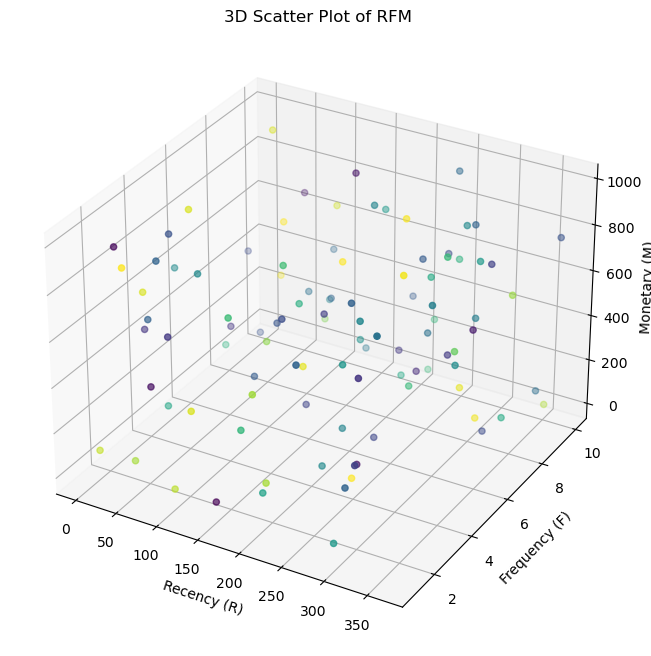

In [27]:
np.random.seed(42)
data_size = 100
lrfm1 = pd.DataFrame({
    'R': np.random.randint(1, 365, data_size),
    'F': np.random.randint(1, 11, data_size),
    'M': np.random.randint(1, 1000, data_size),
    'L': np.random.randint(1, 100, data_size),
})

# Plotting the 3D scatter plot
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(lrfm1['R'], lrfm1['F'], lrfm1['M'], c=lrfm1['L'], marker='o')

ax.set_xlabel('Recency (R)')
ax.set_ylabel('Frequency (F)')
ax.set_zlabel('Monetary (M)')
ax.set_title('3D Scatter Plot of RFM')



plt.show()

In [28]:
fig = px.scatter_3d(lrfm, x='R', y='F', z='M',color='L', title='3D Scatter Plot of LRFM')
fig.show()

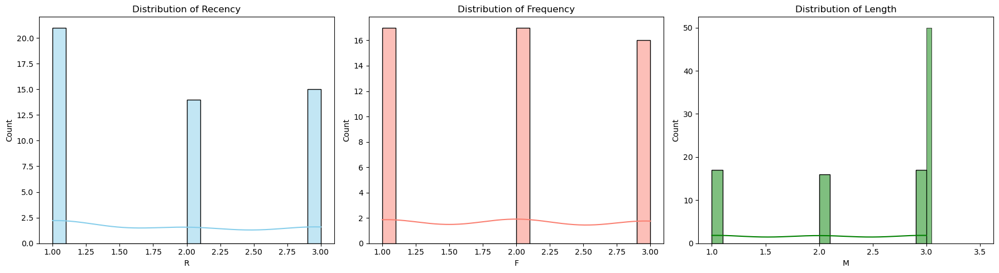

In [29]:
# Assuming your dataset is stored in a DataFrame called 'df'
# If not, you can load your data using pd.read_csv or pd.read_excel

# Plot histograms for Recency, Frequency, and Monetary values
plt.figure(figsize=(18, 5))

# Plot for Recency
plt.subplot(1, 3, 1)
sns.histplot(lrfm['R'], bins=20, kde=True, color='skyblue')
plt.title('Distribution of Recency')

# Plot for Frequency
plt.subplot(1, 3, 2)
sns.histplot(lrfm['F'], bins=20, kde=True, color='salmon')
plt.title('Distribution of Frequency')

# Plot for Monetary
plt.subplot(1, 3, 3)
sns.histplot(lrfm['M'], bins=20, kde=True, color='green')
plt.title('Distribution of Monetary')

# Plot for Length
plt.subplot(1, 3, 3)
sns.histplot(lrfm['L'], bins=20, kde=True, color='green')
plt.title('Distribution of Length')

plt.tight_layout()
plt.show()

D:\Anaconda\Lib\site-packages\seaborn\axisgrid.py:118: UserWarning:

The figure layout has changed to tight



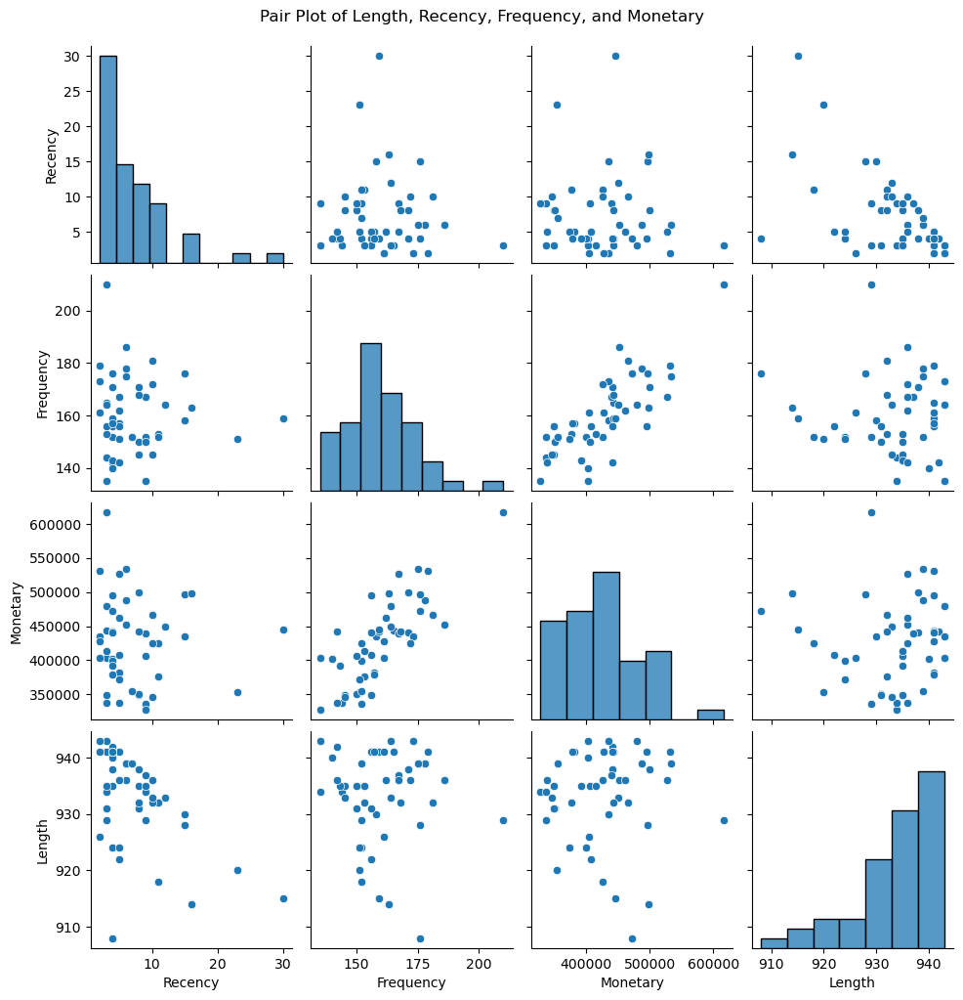

In [30]:
# Select relevant columns for the pair plot
columns_for_pair_plot = ['Recency', 'Frequency', 'Monetary', 'Length']


# Create pair plot
sns.pairplot(lrfm[columns_for_pair_plot])
plt.suptitle('Pair Plot of Length, Recency, Frequency, and Monetary', y=1.02)
plt.show()

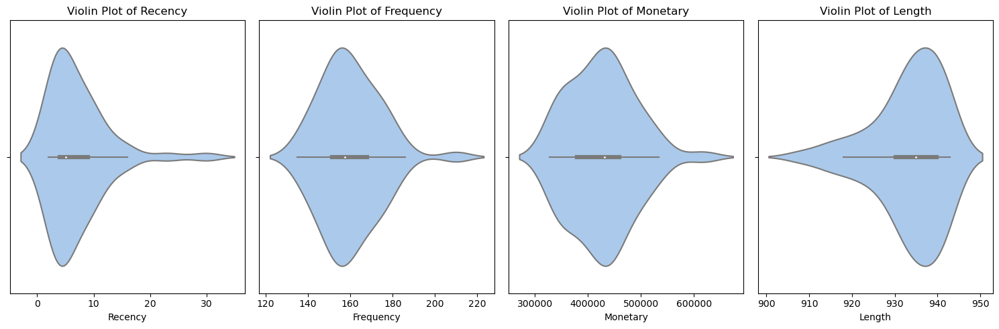

In [31]:
# Select relevant columns for the violin plots
columns_for_violin_plot = ['Recency', 'Frequency', 'Monetary','Length']

# Create a figure with subplots
fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(15, 5))

# Create violin plots for Recency, Frequency, and Monetary
for i, column in enumerate(columns_for_violin_plot):
    sns.violinplot(x=lrfm[column], ax=axes[i], palette='pastel')
    axes[i].set_title(f'Violin Plot of {column}')

plt.tight_layout()
plt.show()

In [32]:
LRFM = lrfm.copy()


LRFM = LRFM.drop(columns=['lrfm_group'])

LRFM['lrfm'] = LRFM['R'] * 1000 + LRFM['F'] * 100 + LRFM['M'] * 10 + LRFM['L']

LRFM

,Recency,Frequency,Monetary,Length,R,F,M,L,lrfm_score_total,lrfm
_CustomerID,,,,,,,,,,
1,9,152,335933.6115,929,3,1,1,3,8,3113
10,15,158,435122.1870,930,3,2,2,3,10,3223
11,6,178,487614.2415,939,2,3,3,3,11,2333
12,3,210,616719.2550,929,1,3,3,3,10,1333
13,4,171,441003.2795,938,1,3,2,3,9,1323
14,5,157,381450.0280,941,2,2,1,3,8,2213
15,4,142,441668.3550,942,1,1,2,3,7,1123
16,3,135,402938.7705,943,1,1,2,3,7,1123
17,6,175,534027.3860,939,2,3,3,3,11,2333


In [33]:
Z = LRFM[['L','R','F','M']]

# Choose the number of clusters (you can tune this parameter)
n_clusters = 30

# Apply DBSCAN clustering
dbscan = DBSCAN(eps=0.00000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000000001, min_samples=1)  # You may need to tune eps and min_samples
LRFM['DBSCANClusters'] = dbscan.fit_predict(Z)

# RFM[2] = RFM[2][RFM[2]['DBSCANClusters'] != -1]
# s = set(LRFM[2]['LRFM'])
# s

# # Display the resulting DataFrame
LRFM

,Recency,Frequency,Monetary,Length,R,F,M,L,lrfm_score_total,lrfm,DBSCANClusters
_CustomerID,,,,,,,,,,,
1,9,152,335933.6115,929,3,1,1,3,8,3113,0
10,15,158,435122.1870,930,3,2,2,3,10,3223,1
11,6,178,487614.2415,939,2,3,3,3,11,2333,2
12,3,210,616719.2550,929,1,3,3,3,10,1333,3
13,4,171,441003.2795,938,1,3,2,3,9,1323,4
14,5,157,381450.0280,941,2,2,1,3,8,2213,5
15,4,142,441668.3550,942,1,1,2,3,7,1123,6
16,3,135,402938.7705,943,1,1,2,3,7,1123,6
17,6,175,534027.3860,939,2,3,3,3,11,2333,2


<Axes: xlabel='F', ylabel='M'>

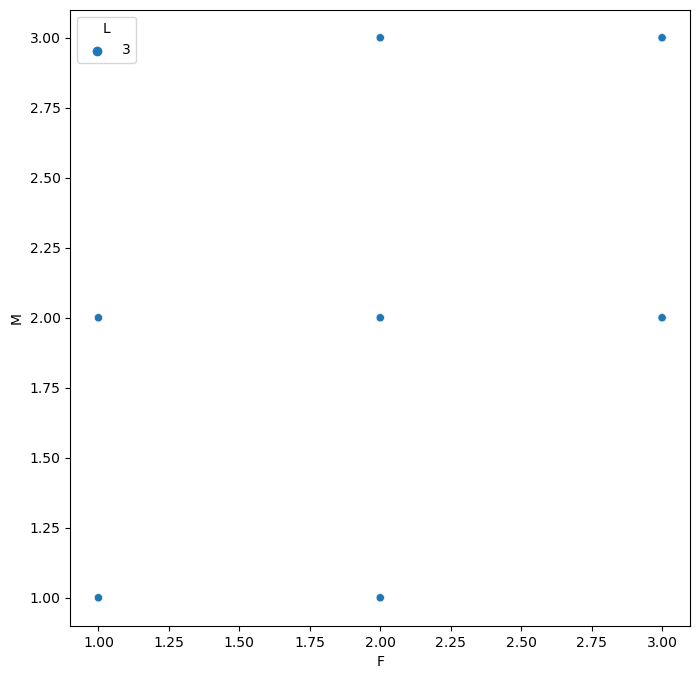

In [34]:
plt.figure(figsize=(8,8))
sns.scatterplot(data = LRFM, x='F', y='M', hue='L', palette='tab10')

In [35]:
# Set the environment variable to avoid KMeans memory leak warning
os.environ['OMP_NUM_THREADS'] = '1'

# Need specifications

# Your data
Y = LRFM[['L', 'R', 'F', 'M']]

# Choose the number of clusters (you can tune this parameter)
n_clusters = 20

# Apply Gaussian Mixture Model clustering
gmm = GaussianMixture(n_components=n_clusters, random_state=42)  # You may need to adjust other parameters
LRFM['GMMClusters'] = gmm.fit_predict(Y)

# Display the resulting DataFrame
LRFM

D:\Anaconda\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.



,Recency,Frequency,Monetary,Length,R,F,M,L,lrfm_score_total,lrfm,DBSCANClusters,GMMClusters
_CustomerID,,,,,,,,,,,,
1,9,152,335933.6115,929,3,1,1,3,8,3113,0,4
10,15,158,435122.1870,930,3,2,2,3,10,3223,1,18
11,6,178,487614.2415,939,2,3,3,3,11,2333,2,2
12,3,210,616719.2550,929,1,3,3,3,10,1333,3,5
13,4,171,441003.2795,938,1,3,2,3,9,1323,4,10
14,5,157,381450.0280,941,2,2,1,3,8,2213,5,17
15,4,142,441668.3550,942,1,1,2,3,7,1123,6,15
16,3,135,402938.7705,943,1,1,2,3,7,1123,6,15
17,6,175,534027.3860,939,2,3,3,3,11,2333,2,2


In [36]:
from sklearn.cluster import AgglomerativeClustering
# Need specifications
# Your data
A = LRFM[['L', 'R', 'F', 'M']]

# Choose the number of clusters (you can tune this parameter)
n_clusters = 20

# Apply Agglomerative Clustering
agglomerative = AgglomerativeClustering(n_clusters=n_clusters)
LRFM['AgglomerativeClusters'] = agglomerative.fit_predict(A)

# Display the resulting DataFrame
LRFM


,Recency,Frequency,Monetary,Length,R,F,M,L,lrfm_score_total,lrfm,DBSCANClusters,GMMClusters,AgglomerativeClusters
_CustomerID,,,,,,,,,,,,,
1,9,152,335933.6115,929,3,1,1,3,8,3113,0,4,6
10,15,158,435122.1870,930,3,2,2,3,10,3223,1,18,19
11,6,178,487614.2415,939,2,3,3,3,11,2333,2,2,3
12,3,210,616719.2550,929,1,3,3,3,10,1333,3,5,1
13,4,171,441003.2795,938,1,3,2,3,9,1323,4,10,10
14,5,157,381450.0280,941,2,2,1,3,8,2213,5,17,18
15,4,142,441668.3550,942,1,1,2,3,7,1123,6,15,5
16,3,135,402938.7705,943,1,1,2,3,7,1123,6,15,5
17,6,175,534027.3860,939,2,3,3,3,11,2333,2,2,3


In [37]:
# Only 0 and 1 despite being dynamic

# Data to be clustered
B = LRFM[['L', 'R', 'F', 'M']]

# Apply MeanShift clustering
meanshift = MeanShift()  # You may need to adjust bandwidth and other parameters
LRFM['MeanShiftClusters'] = meanshift.fit_predict(B)
# LRFM['MeanShiftClusters'] = label_encoder.fit_transform(LRFM[2]['MeanShiftClusters'])


# Display the resulting DataFrame
LRFM

,Recency,Frequency,Monetary,Length,R,F,M,L,lrfm_score_total,lrfm,DBSCANClusters,GMMClusters,AgglomerativeClusters,MeanShiftClusters
_CustomerID,,,,,,,,,,,,,,
1,9,152,335933.6115,929,3,1,1,3,8,3113,0,4,6,1
10,15,158,435122.1870,930,3,2,2,3,10,3223,1,18,19,0
11,6,178,487614.2415,939,2,3,3,3,11,2333,2,2,3,0
12,3,210,616719.2550,929,1,3,3,3,10,1333,3,5,1,0
13,4,171,441003.2795,938,1,3,2,3,9,1323,4,10,10,0
14,5,157,381450.0280,941,2,2,1,3,8,2213,5,17,18,1
15,4,142,441668.3550,942,1,1,2,3,7,1123,6,15,5,1
16,3,135,402938.7705,943,1,1,2,3,7,1123,6,15,5,1
17,6,175,534027.3860,939,2,3,3,3,11,2333,2,2,3,0


In [38]:
#Not enough dynamically created clusters
# Data to be clustered

C = LRFM[['L', 'R', 'F', 'M']]

# Apply Affinity Propagation clustering
affinity_propagation = AffinityPropagation(random_state=42)
LRFM['AffinityPropagationClusters'] = affinity_propagation.fit_predict(C)

# Display the resulting DataFrame
LRFM

,Recency,Frequency,Monetary,Length,R,F,M,L,lrfm_score_total,lrfm,DBSCANClusters,GMMClusters,AgglomerativeClusters,MeanShiftClusters,AffinityPropagationClusters
_CustomerID,,,,,,,,,,,,,,,
1,9,152,335933.6115,929,3,1,1,3,8,3113,0,4,6,1,0
10,15,158,435122.1870,930,3,2,2,3,10,3223,1,18,19,0,1
11,6,178,487614.2415,939,2,3,3,3,11,2333,2,2,3,0,4
12,3,210,616719.2550,929,1,3,3,3,10,1333,3,5,1,0,2
13,4,171,441003.2795,938,1,3,2,3,9,1323,4,10,10,0,2
14,5,157,381450.0280,941,2,2,1,3,8,2213,5,17,18,1,6
15,4,142,441668.3550,942,1,1,2,3,7,1123,6,15,5,1,3
16,3,135,402938.7705,943,1,1,2,3,7,1123,6,15,5,1,3
17,6,175,534027.3860,939,2,3,3,3,11,2333,2,2,3,0,4


In [39]:
# Access cluster centers
cluster_centers = affinity_propagation.cluster_centers_

# Access the number of clusters
n_clusters_affinity = len(cluster_centers)

# Print the number of clusters
print(f"Number of clusters (Affinity Propagation): {cluster_centers}")

Number of clusters (Affinity Propagation): [[3 3 1 1]
 [3 3 2 2]
 [3 1 3 3]
 [3 1 1 1]
 [3 2 3 3]
 [3 1 2 2]
 [3 2 1 1]]


In [40]:
# plt.figure(figsize=(8,8))
# sns.scatterplot(data = RFM[2], x='F', y='M', hue='DBSCANClusters', palette='tab10')

In [41]:
# Your data
# Couldn't read data in -1 (outliers)

D = LRFM[['L', 'R', 'F', 'M']]

# Apply OPTICS clustering
optics = OPTICS(min_samples=2)  # You may need to adjust other parameters
LRFM['OPTICSClusters'] = optics.fit_predict(D)

# Display the resulting DataFrame
LRFM

D:\Anaconda\Lib\site-packages\sklearn\cluster\_optics.py:992: RuntimeWarning:

divide by zero encountered in divide



,Recency,Frequency,Monetary,Length,R,F,M,L,lrfm_score_total,lrfm,DBSCANClusters,GMMClusters,AgglomerativeClusters,MeanShiftClusters,AffinityPropagationClusters,OPTICSClusters
_CustomerID,,,,,,,,,,,,,,,,
1,9,152,335933.6115,929,3,1,1,3,8,3113,0,4,6,1,0,0
10,15,158,435122.1870,930,3,2,2,3,10,3223,1,18,19,0,1,-1
11,6,178,487614.2415,939,2,3,3,3,11,2333,2,2,3,0,4,3
12,3,210,616719.2550,929,1,3,3,3,10,1333,3,5,1,0,2,4
13,4,171,441003.2795,938,1,3,2,3,9,1323,4,10,10,0,2,5
14,5,157,381450.0280,941,2,2,1,3,8,2213,5,17,18,1,6,-1
15,4,142,441668.3550,942,1,1,2,3,7,1123,6,15,5,1,3,9
16,3,135,402938.7705,943,1,1,2,3,7,1123,6,15,5,1,3,9
17,6,175,534027.3860,939,2,3,3,3,11,2333,2,2,3,0,4,3


In [42]:
#Needs Specification

# Your data

F = LRFM[['L', 'R', 'F', 'M']]

# Choose the number of clusters (you can tune this parameter)
n_clusters = 20

# Apply Spectral Clustering
spectral = SpectralClustering(n_clusters=n_clusters, random_state=42, n_init=10, affinity='nearest_neighbors')  # You may need to adjust other parameters
LRFM['SpectralClusters'] = spectral.fit_predict(F)

# Display the resulting DataFrame
LRFM

D:\Anaconda\Lib\site-packages\sklearn\cluster\_kmeans.py:1436: UserWarning:

KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.



,Recency,Frequency,Monetary,Length,R,F,M,L,lrfm_score_total,lrfm,DBSCANClusters,GMMClusters,AgglomerativeClusters,MeanShiftClusters,AffinityPropagationClusters,OPTICSClusters,SpectralClusters
_CustomerID,,,,,,,,,,,,,,,,,
1,9,152,335933.6115,929,3,1,1,3,8,3113,0,4,6,1,0,0,6
10,15,158,435122.1870,930,3,2,2,3,10,3223,1,18,19,0,1,-1,9
11,6,178,487614.2415,939,2,3,3,3,11,2333,2,2,3,0,4,3,19
12,3,210,616719.2550,929,1,3,3,3,10,1333,3,5,1,0,2,4,1
13,4,171,441003.2795,938,1,3,2,3,9,1323,4,10,10,0,2,5,17
14,5,157,381450.0280,941,2,2,1,3,8,2213,5,17,18,1,6,-1,0
15,4,142,441668.3550,942,1,1,2,3,7,1123,6,15,5,1,3,9,2
16,3,135,402938.7705,943,1,1,2,3,7,1123,6,15,5,1,3,9,2
17,6,175,534027.3860,939,2,3,3,3,11,2333,2,2,3,0,4,3,1


In [43]:
# Your data
G = LRFM[['L', 'R', 'F', 'M']]

# Choose the number of clusters (you can tune this parameter)
n_clusters = 30

# Apply Birch clustering
birch = Birch(n_clusters=n_clusters, threshold=0.1)  # You may need to adjust other parameters
LRFM['BirchClusters'] = birch.fit_predict(G)

# Display the resulting DataFrame
LRFM


D:\Anaconda\Lib\site-packages\sklearn\cluster\_birch.py:725: ConvergenceWarning:

Number of subclusters found (20) by BIRCH is less than (30). Decrease the threshold.



,Recency,Frequency,Monetary,Length,R,F,M,L,lrfm_score_total,lrfm,DBSCANClusters,GMMClusters,AgglomerativeClusters,MeanShiftClusters,AffinityPropagationClusters,OPTICSClusters,SpectralClusters,BirchClusters
_CustomerID,,,,,,,,,,,,,,,,,,
1,9,152,335933.6115,929,3,1,1,3,8,3113,0,4,6,1,0,0,6,0
10,15,158,435122.1870,930,3,2,2,3,10,3223,1,18,19,0,1,-1,9,1
11,6,178,487614.2415,939,2,3,3,3,11,2333,2,2,3,0,4,3,19,2
12,3,210,616719.2550,929,1,3,3,3,10,1333,3,5,1,0,2,4,1,3
13,4,171,441003.2795,938,1,3,2,3,9,1323,4,10,10,0,2,5,17,4
14,5,157,381450.0280,941,2,2,1,3,8,2213,5,17,18,1,6,-1,0,5
15,4,142,441668.3550,942,1,1,2,3,7,1123,6,15,5,1,3,9,2,6
16,3,135,402938.7705,943,1,1,2,3,7,1123,6,15,5,1,3,9,2,6
17,6,175,534027.3860,939,2,3,3,3,11,2333,2,2,3,0,4,3,1,2


In [44]:
# # finding clusters:

# # Needs Specifications
# # Changes the data with another execution

# os.environ['OMP_NUM_THREADS'] = '1'

# E = LRFM[2][['L', 'R','F','M']]

# km = KMeans(n_clusters = 20, init = 'k-means++', n_init=10)

# nclusters = km.fit_predict(E)

# clusters = pd.DataFrame(nclusters, columns = ['KMeansClusters'], index = LRFM[2].index)

# # Concatenating the clusters with the RFM dataframe:
# LRFM[2] = pd.concat([LRFM[2], clusters], axis=1)
# LRFM[2]

s = set(LRFM['lrfm'])
s
len(s)

# LRFM[2]

# c = LRFM[2][LRFM[2]['DBSCANClusters'] == 0]
# c

20

In [45]:
cluster_counts = LRFM['DBSCANClusters'].value_counts()

# Display the counts
cluster_counts

DBSCANClusters
2     5
15    5
13    5
0     4
9     4
3     4
10    3
7     2
8     2
6     2
14    2
4     2
16    2
17    2
1     1
11    1
12    1
5     1
18    1
19    1
Name: count, dtype: int64

<Axes: xlabel='Frequency', ylabel='Monetary'>

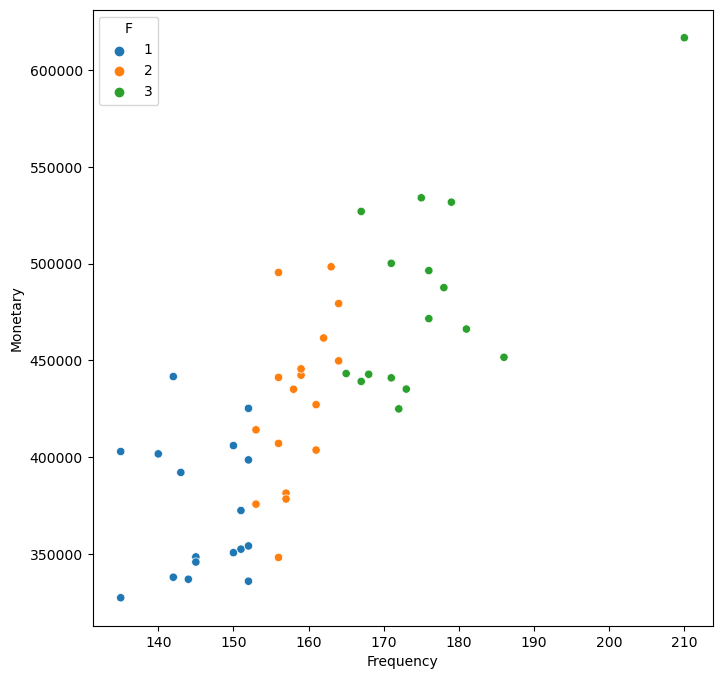

In [46]:
plt.figure(figsize=(8,8))
sns.scatterplot(data = LRFM, x='Frequency', y='Monetary', hue='F', palette='tab10')

In [47]:
#     19: "Long-Time Frequent Buyers",
#     18: "Balanced Loyalists",
#     17: "Cost-Conscious Product Buyers",
#     16: "Occasional Buyers",
#     15: "Continuously Moderate Spenders",
#     14: "Currently Lost High-Value Customers",
#     13: "Offer loving Cost-Conscious Veterans",
#     12: "Less Interested Consumers",
#     11: "Moderately Involved High Spending Veterans",
#     10: "Irregular yet Frequent VIPs",
#     9: "Cost-Conscious Constant Buyers",
#     8: "Losing Long-Time High Spenders",
#     7: "Momentary but Multiple Products Buyers",
#     6: "Deal Seeking Customers",
#     5: "Emerging Cost-Conscious Loyalists",
#     4: "Semi-Premium Customers",
#     3: "Elite/Perfect Customers",
#     2: "Weekly Overspending Veterans",
#     1: "Irregular & Moderate Buyers",
#     0: "Least Interested Customers"


# Assuming the DBSCANClusters values range from 0 to 19

cluster_labels = {
    19: "Long-Time Frequent Buyers",
    18: "Balanced Loyalists",
    17: "Cost-Conscious Product Buyers",
    16: "Occasional Buyers",
    15: "Continuously Moderate Spenders",
    14: "Currently Lost High-Value Customers",
    13: "Offer loving Cost-Conscious Veterans",
    12: "Less Interested Consumers",
    11: "Moderately Involved High Spending Veterans",
    10: "Irregular yet Frequent VIPs",
    9: "Cost-Conscious Constant Buyers",
    8: "Losing Long-Time High Spenders",
    7: "Momentary but Multiple Products Buyers",
    6: "Deal Seeking Customers",
    5: "Emerging Cost-Conscious Loyalists",
    4: "Semi-Premium Customers",
    3: "Elite/Perfect Customers",
    2: "Weekly Overspending Veterans",
    1: "Irregular & Moderate Buyers",
    0: "Least Interested Customers"
}

# Assign labels based on DBSCANClusters values
LRFM['Conclusion_DBSCAN'] = LRFM['DBSCANClusters'].map(cluster_labels)
LRFM

,Recency,Frequency,Monetary,Length,R,F,M,L,lrfm_score_total,lrfm,DBSCANClusters,GMMClusters,AgglomerativeClusters,MeanShiftClusters,AffinityPropagationClusters,OPTICSClusters,SpectralClusters,BirchClusters,Conclusion_DBSCAN
_CustomerID,,,,,,,,,,,,,,,,,,,
1,9,152,335933.6115,929,3,1,1,3,8,3113,0,4,6,1,0,0,6,0,Least Interested Customers
10,15,158,435122.1870,930,3,2,2,3,10,3223,1,18,19,0,1,-1,9,1,Irregular & Moderate Buyers
11,6,178,487614.2415,939,2,3,3,3,11,2333,2,2,3,0,4,3,19,2,Weekly Overspending Veterans
12,3,210,616719.2550,929,1,3,3,3,10,1333,3,5,1,0,2,4,1,3,Elite/Perfect Customers
13,4,171,441003.2795,938,1,3,2,3,9,1323,4,10,10,0,2,5,17,4,Semi-Premium Customers
14,5,157,381450.0280,941,2,2,1,3,8,2213,5,17,18,1,6,-1,0,5,Emerging Cost-Conscious Loyalists
15,4,142,441668.3550,942,1,1,2,3,7,1123,6,15,5,1,3,9,2,6,Deal Seeking Customers
16,3,135,402938.7705,943,1,1,2,3,7,1123,6,15,5,1,3,9,2,6,Deal Seeking Customers
17,6,175,534027.3860,939,2,3,3,3,11,2333,2,2,3,0,4,3,1,2,Weekly Overspending Veterans


In [48]:
print(LRFM[['lrfm', 'DBSCANClusters', 'Conclusion_DBSCAN']])

             lrfm  DBSCANClusters                           Conclusion_DBSCAN
_CustomerID                                                                  
1            3113               0                  Least Interested Customers
10           3223               1                 Irregular & Moderate Buyers
11           2333               2                Weekly Overspending Veterans
12           1333               3                     Elite/Perfect Customers
13           1323               4                      Semi-Premium Customers
14           2213               5           Emerging Cost-Conscious Loyalists
15           1123               6                      Deal Seeking Customers
16           1123               6                      Deal Seeking Customers
17           2333               2                Weekly Overspending Veterans
18           2333               2                Weekly Overspending Veterans
19           1333               3                     Elite/Perf

In [49]:
l = ['L', 'F', 'M']

for col in l:
    conditions = [
        LRFM[col].eq(1),
        LRFM[col].eq(2)
    ]
    choices = ['Low', 'Medium']

    LRFM[f'Status{col}'] = np.select(conditions, choices, default='High')
LRFM

,Recency,Frequency,Monetary,Length,R,F,M,L,lrfm_score_total,lrfm,...,AgglomerativeClusters,MeanShiftClusters,AffinityPropagationClusters,OPTICSClusters,SpectralClusters,BirchClusters,Conclusion_DBSCAN,StatusL,StatusF,StatusM
_CustomerID,,,,,,,,,,,,,,,,,,,,,
1,9,152,335933.6115,929,3,1,1,3,8,3113,...,6,1,0,0,6,0,Least Interested Customers,High,Low,Low
10,15,158,435122.1870,930,3,2,2,3,10,3223,...,19,0,1,-1,9,1,Irregular & Moderate Buyers,High,Medium,Medium
11,6,178,487614.2415,939,2,3,3,3,11,2333,...,3,0,4,3,19,2,Weekly Overspending Veterans,High,High,High
12,3,210,616719.2550,929,1,3,3,3,10,1333,...,1,0,2,4,1,3,Elite/Perfect Customers,High,High,High
13,4,171,441003.2795,938,1,3,2,3,9,1323,...,10,0,2,5,17,4,Semi-Premium Customers,High,High,Medium
14,5,157,381450.0280,941,2,2,1,3,8,2213,...,18,1,6,-1,0,5,Emerging Cost-Conscious Loyalists,High,Medium,Low
15,4,142,441668.3550,942,1,1,2,3,7,1123,...,5,1,3,9,2,6,Deal Seeking Customers,High,Low,Medium
16,3,135,402938.7705,943,1,1,2,3,7,1123,...,5,1,3,9,2,6,Deal Seeking Customers,High,Low,Medium
17,6,175,534027.3860,939,2,3,3,3,11,2333,...,3,0,4,3,1,2,Weekly Overspending Veterans,High,High,High


In [50]:
conditions = [
    LRFM['R'] == 1,
    LRFM['R'] == 2
]

choices = ['High', 'Medium']

LRFM['StatusR'] = np.select(conditions, choices, default='Low')
LRFM

,Recency,Frequency,Monetary,Length,R,F,M,L,lrfm_score_total,lrfm,...,MeanShiftClusters,AffinityPropagationClusters,OPTICSClusters,SpectralClusters,BirchClusters,Conclusion_DBSCAN,StatusL,StatusF,StatusM,StatusR
_CustomerID,,,,,,,,,,,,,,,,,,,,,
1,9,152,335933.6115,929,3,1,1,3,8,3113,...,1,0,0,6,0,Least Interested Customers,High,Low,Low,Low
10,15,158,435122.1870,930,3,2,2,3,10,3223,...,0,1,-1,9,1,Irregular & Moderate Buyers,High,Medium,Medium,Low
11,6,178,487614.2415,939,2,3,3,3,11,2333,...,0,4,3,19,2,Weekly Overspending Veterans,High,High,High,Medium
12,3,210,616719.2550,929,1,3,3,3,10,1333,...,0,2,4,1,3,Elite/Perfect Customers,High,High,High,High
13,4,171,441003.2795,938,1,3,2,3,9,1323,...,0,2,5,17,4,Semi-Premium Customers,High,High,Medium,High
14,5,157,381450.0280,941,2,2,1,3,8,2213,...,1,6,-1,0,5,Emerging Cost-Conscious Loyalists,High,Medium,Low,Medium
15,4,142,441668.3550,942,1,1,2,3,7,1123,...,1,3,9,2,6,Deal Seeking Customers,High,Low,Medium,High
16,3,135,402938.7705,943,1,1,2,3,7,1123,...,1,3,9,2,6,Deal Seeking Customers,High,Low,Medium,High
17,6,175,534027.3860,939,2,3,3,3,11,2333,...,0,4,3,1,2,Weekly Overspending Veterans,High,High,High,Medium


D:\Anaconda\Lib\site-packages\plotnine\geoms\geom_path.py:111: PlotnineWarning:

geom_path: Each group consist of only one observation. Do you need to adjust the group aesthetic?

D:\Anaconda\Lib\site-packages\plotnine\geoms\geom_path.py:111: PlotnineWarning:

geom_path: Each group consist of only one observation. Do you need to adjust the group aesthetic?

D:\Anaconda\Lib\site-packages\plotnine\geoms\geom_path.py:111: PlotnineWarning:

geom_path: Each group consist of only one observation. Do you need to adjust the group aesthetic?

D:\Anaconda\Lib\site-packages\plotnine\geoms\geom_path.py:111: PlotnineWarning:

geom_path: Each group consist of only one observation. Do you need to adjust the group aesthetic?



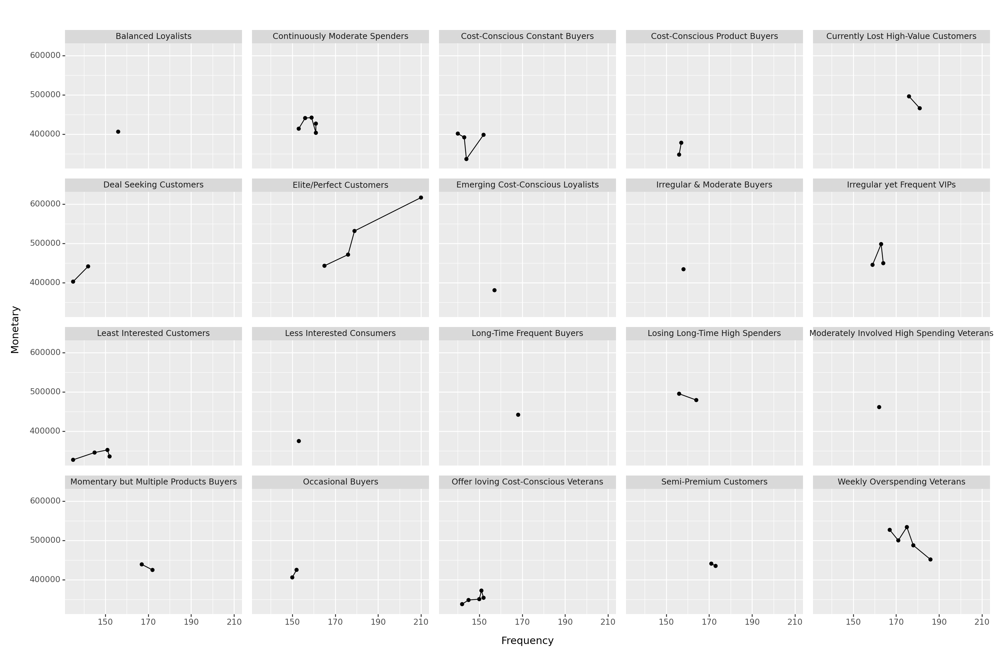

In [51]:
# Assuming LRFM[2] contains your data
p = ggplot(LRFM, aes('Frequency', 'Monetary', group='Conclusion_DBSCAN')) \
    + geom_line() \
    + geom_point() \
    + facet_wrap('Conclusion_DBSCAN') \
    + scale_x_continuous() \
    + theme(figure_size=(15, 10))  # Adjust the figure size as needed

print(p)

In [52]:
# Set the style for better visualization (optional)
sns.set(style="whitegrid")

# Bar plot for LRFM features by Conclusion_DBSCAN clusters
plt.figure(figsize=(70, 70))
ax = sns.barplot(x='Conclusion_DBSCAN', y='Recency', data=LRFM, errorbar=None)

# Manually set x-axis ticks and labels
ax.set_xticks(range(len(LRFM['Conclusion_DBSCAN'].unique())))
ax.set_xticklabels(LRFM['Conclusion_DBSCAN'].unique(), rotation=30, ha='right')

plt.title('Average Recency of Specific Customers', fontsize=50)
plt.xlabel('Segmented Customers', fontsize=40)
plt.ylabel('Recency', fontsize=40)

# Adjust the font size for the x-axis and y-axis
ax.tick_params(axis='both', labelsize=40)

# Display counts on top of each bar with optimized annotation
for p, count in zip(ax.patches, cluster_counts):
    ax.annotate(f'Amt: {count}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=40, color='black', xytext=(0, 20),
                textcoords='offset points')

    # Display the actual value of the bar inside the bar
    ax.text(p.get_x() + p.get_width() / 2., p.get_height() / 2., f'{int(p.get_height())}',
            ha='center', va='center', fontsize=40, color='black')

# Show the plot
plt.show()

In [53]:
# Set the style for better visualization (optional)
sns.set(style="whitegrid")

# Bar plot for LRFM features by Conclusion_DBSCAN clusters
plt.figure(figsize=(70, 70))
ax = sns.barplot(x='Conclusion_DBSCAN', y='Frequency', data=LRFM, errorbar=None)

# Manually set x-axis ticks and labels
ax.set_xticks(range(len(LRFM['Conclusion_DBSCAN'].unique())))
ax.set_xticklabels(LRFM['Conclusion_DBSCAN'].unique(), rotation=30, ha='right')

plt.title('Average Frequency of Specific Customers', fontsize=50)
plt.xlabel('Segmented Customers', fontsize=40)
plt.ylabel('Frequency', fontsize=40)

# Adjust the font size for the x-axis and y-axis
ax.tick_params(axis='both', labelsize=40)

# Display counts on top of each bar with optimized annotation
for p, count in zip(ax.patches, cluster_counts):
    ax.annotate(f'Amt: {count}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=40, color='black', xytext=(0, 20),
                textcoords='offset points')

    # Display the actual value of the bar inside the bar
    ax.text(p.get_x() + p.get_width() / 2., p.get_height() / 2., f'{int(p.get_height())}',
            ha='center', va='center', fontsize=40, color='black')

# Show the plot
plt.show()

In [54]:
# Set the style for better visualization (optional)
sns.set(style="whitegrid")

# Bar plot for LRFM features by Conclusion_DBSCAN clusters
plt.figure(figsize=(70, 70))
ax = sns.barplot(x='Conclusion_DBSCAN', y='Monetary', data=LRFM, errorbar=None)

# Manually set x-axis ticks and labels
ax.set_xticks(range(len(LRFM['Conclusion_DBSCAN'].unique())))
ax.set_xticklabels(LRFM['Conclusion_DBSCAN'].unique(), rotation=30, ha='right')

plt.title('Average Monetary Value of Specific Customers', fontsize=50)
plt.xlabel('Segmented Customers', fontsize=40)
plt.ylabel('Monetary Value', fontsize=40)

# Adjust the font size for the x-axis and y-axis
ax.tick_params(axis='both', labelsize=40)

# Display counts on top of each bar with optimized annotation
for p, count in zip(ax.patches, cluster_counts):
    ax.annotate(f'Amt: {count}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=40, color='black', xytext=(0, 20),
                textcoords='offset points')

    # Display the actual value of the bar inside the bar
    ax.text(p.get_x() + p.get_width() / 2., p.get_height() / 2., f'{int(p.get_height())}',
            ha='center', va='center', fontsize=40, color='black')

# Show the plot
plt.show()

In [55]:
# Set the style for better visualization (optional)
sns.set(style="whitegrid")

# Bar plot for LRFM features by Conclusion_DBSCAN clusters
plt.figure(figsize=(70, 70))
ax = sns.barplot(x='Conclusion_DBSCAN', y='Length', data=LRFM, errorbar=None)

# Manually set x-axis ticks and labels
ax.set_xticks(range(len(LRFM['Conclusion_DBSCAN'].unique())))
ax.set_xticklabels(LRFM['Conclusion_DBSCAN'].unique(), rotation=30, ha='right')

plt.title('Average Length of Usage of Specific Customers', fontsize=50)
plt.xlabel('Segmented Customers', fontsize=40)
plt.ylabel('Length of Usage', fontsize=40)

# Adjust the font size for the x-axis and y-axis
ax.tick_params(axis='both', labelsize=40)

# Display counts on top of each bar with optimized annotation
for p, count in zip(ax.patches, cluster_counts):
    ax.annotate(f'Amt: {count}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=40, color='black', xytext=(0, 20),
                textcoords='offset points')

    # Display the actual value of the bar inside the bar
    ax.text(p.get_x() + p.get_width() / 2., p.get_height() / 2., f'{int(p.get_height())}',
            ha='center', va='center', fontsize=40, color='black')

# Show the plot
plt.show()

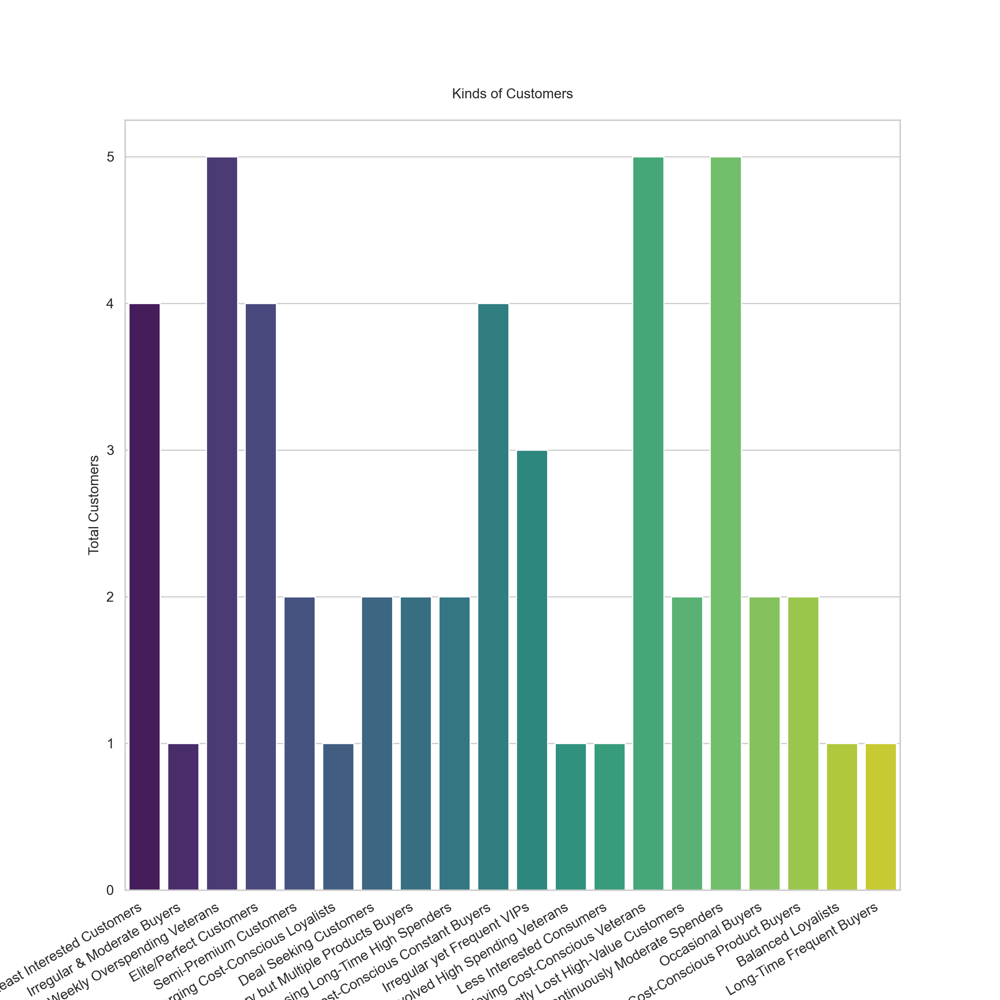

In [56]:
# Assuming your DBSCAN results are in a column named 'Conclusion_DBSCAN'
plt.figure(figsize=(12, 12))
ax = sns.countplot(x='Conclusion_DBSCAN', data=LRFM, palette='viridis')
plt.title('Kinds of Customers\n', fontsize=12)
plt.xlabel('\nSegmented Customers', fontsize=12)
plt.ylabel('Total Customers', fontsize=12)

ax.tick_params(axis='both', labelsize=12)


# Rotate x-axis labels by 45 degrees
ax.set_xticklabels(ax.get_xticklabels(), rotation=30, ha='right')

plt.show()


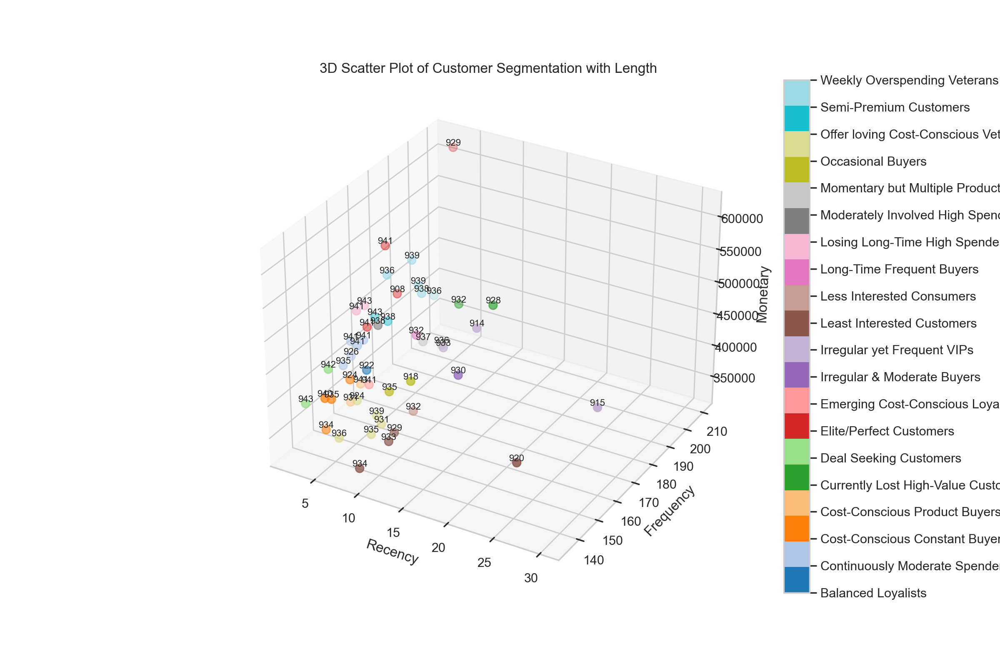

In [57]:
# Assuming you have 'Recency', 'Frequency', 'Monetary', 'Length', and 'Conclusion_DBSCAN' columns
x = LRFM['Recency']
y = LRFM['Frequency']
z = LRFM['Monetary']

# Create and fit a label encoder for 'Conclusion_DBSCAN'
label_encoder = LabelEncoder()
LRFM['DBSCANClusters'] = label_encoder.fit_transform(LRFM['Conclusion_DBSCAN'])

# Create a custom color palette with 20 distinct colors
custom_palette = sns.color_palette("tab20", 20)
cmap = ListedColormap(custom_palette)

# Create a 3D scatter plot
fig = plt.figure(figsize=(12, 8))
ax = fig.add_subplot(111, projection='3d')
scatter = ax.scatter(x, y, z, c=LRFM['DBSCANClusters'], cmap=cmap, s=50)

# Add labels
ax.set_xlabel('Recency')
ax.set_ylabel('Frequency')
ax.set_zlabel('Monetary')

# Add 'Length' as a text annotation for each point above the plot
for i, txt in enumerate(LRFM.index):
    ax.text(x[i], y[i], z[i], f'{LRFM["Length"].loc[txt]}', fontsize=8, ha='center', va='bottom')

# Add a colorbar to show the mapping of colors to clusters
cbar = plt.colorbar(scatter, ax=ax, ticks=range(len(label_encoder.classes_)))
cbar.set_label('Conclusion_DBSCAN')
cbar.set_ticklabels(label_encoder.classes_)

plt.title('3D Scatter Plot of Customer Segmentation with Length')
plt.show()


In [58]:
# Assuming 'Conclusion_DBSCAN' and 'CustomerID' are columns in your DataFrame
hierarchical_data = LRFM.reset_index().groupby(['Conclusion_DBSCAN', '_CustomerID']).agg({
    'Recency': 'sum',
    'Length': 'mean',
    'Frequency': 'first',
    'Monetary': 'first',
    'StatusR': 'first',  # Include other columns here
    'StatusF': 'first',
    'StatusM': 'first',
    'StatusL': 'first',
        # Add other features as needed
}).reset_index()

# Create the tree map
fig = px.treemap(
    hierarchical_data,
    path=['Conclusion_DBSCAN', '_CustomerID'],
    values='Recency',
    color='Length',
    color_continuous_scale='viridis',
    title='Tree Map of Customer Segmentation',
    hover_data={
        '_CustomerID': True,
        'Recency': True,
        'Length': True,
        'Frequency': True,
        'Monetary': True,
        'StatusR': True,
        'StatusF': True,
        'StatusM': True,
        'StatusL': True,
        'Conclusion_DBSCAN': True
    }
)

# # Set the width and height of the plot
# fig.update_layout(width=1200, height=800)

# Set the title to be in the middle
fig.update_layout(title_x=0.5)

# Show the plot
fig.show()

In [59]:
LRFM

,Recency,Frequency,Monetary,Length,R,F,M,L,lrfm_score_total,lrfm,...,MeanShiftClusters,AffinityPropagationClusters,OPTICSClusters,SpectralClusters,BirchClusters,Conclusion_DBSCAN,StatusL,StatusF,StatusM,StatusR
_CustomerID,,,,,,,,,,,,,,,,,,,,,
1,9,152,335933.6115,929,3,1,1,3,8,3113,...,1,0,0,6,0,Least Interested Customers,High,Low,Low,Low
10,15,158,435122.1870,930,3,2,2,3,10,3223,...,0,1,-1,9,1,Irregular & Moderate Buyers,High,Medium,Medium,Low
11,6,178,487614.2415,939,2,3,3,3,11,2333,...,0,4,3,19,2,Weekly Overspending Veterans,High,High,High,Medium
12,3,210,616719.2550,929,1,3,3,3,10,1333,...,0,2,4,1,3,Elite/Perfect Customers,High,High,High,High
13,4,171,441003.2795,938,1,3,2,3,9,1323,...,0,2,5,17,4,Semi-Premium Customers,High,High,Medium,High
14,5,157,381450.0280,941,2,2,1,3,8,2213,...,1,6,-1,0,5,Emerging Cost-Conscious Loyalists,High,Medium,Low,Medium
15,4,142,441668.3550,942,1,1,2,3,7,1123,...,1,3,9,2,6,Deal Seeking Customers,High,Low,Medium,High
16,3,135,402938.7705,943,1,1,2,3,7,1123,...,1,3,9,2,6,Deal Seeking Customers,High,Low,Medium,High
17,6,175,534027.3860,939,2,3,3,3,11,2333,...,0,4,3,1,2,Weekly Overspending Veterans,High,High,High,Medium


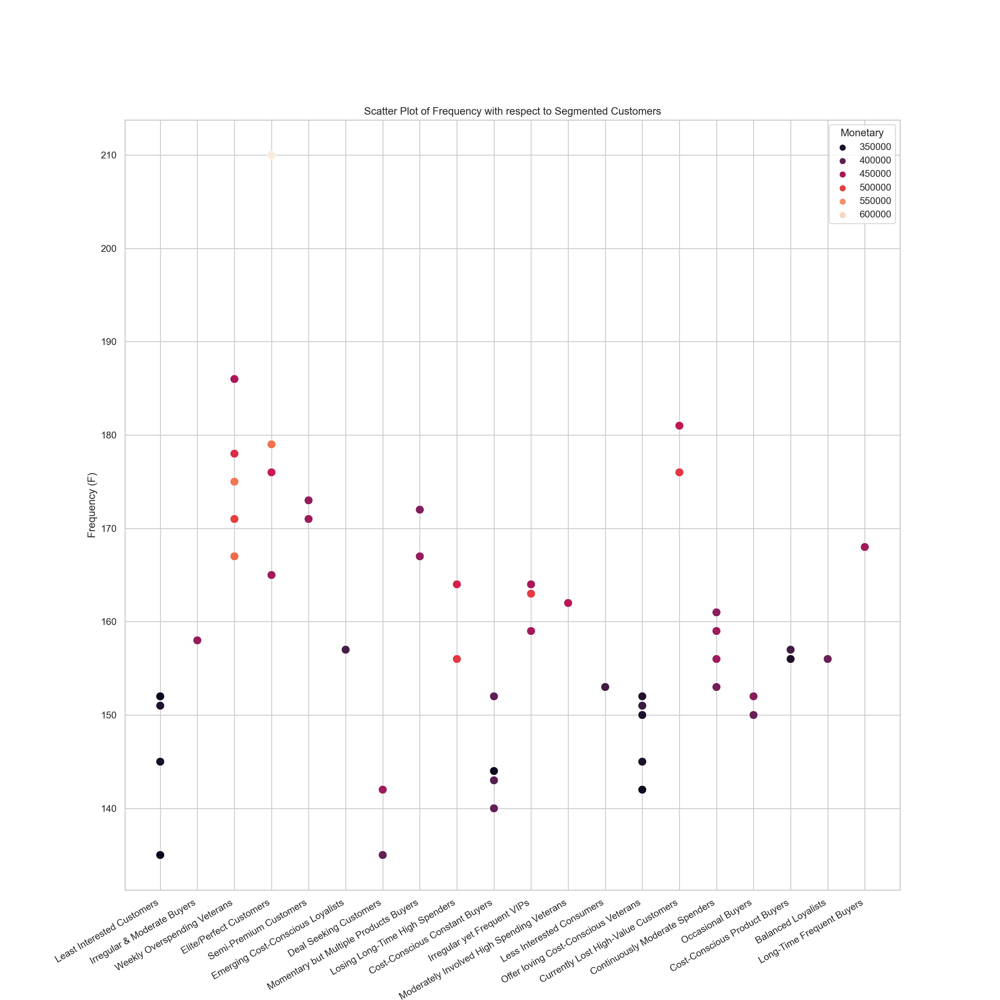

In [60]:
# Set the size of the plot
plt.figure(figsize=(16, 16))

# Scatter plot with 'F' and 'M' as axes, color by 'Conclusion_DBSCAN'
scatter = sns.scatterplot(x='Conclusion_DBSCAN', y='Frequency', hue='Monetary', data=LRFM, palette='rocket', s=100)

# Rotate x-axis labels to the right by 45 degrees
plt.xticks(rotation=30, ha='right')

# Set plot title and labels
plt.title('Scatter Plot of Frequency with respect to Segmented Customers')
plt.xlabel('Segmented Customers')
plt.ylabel('Frequency (F)')

# Show the plot
plt.show()

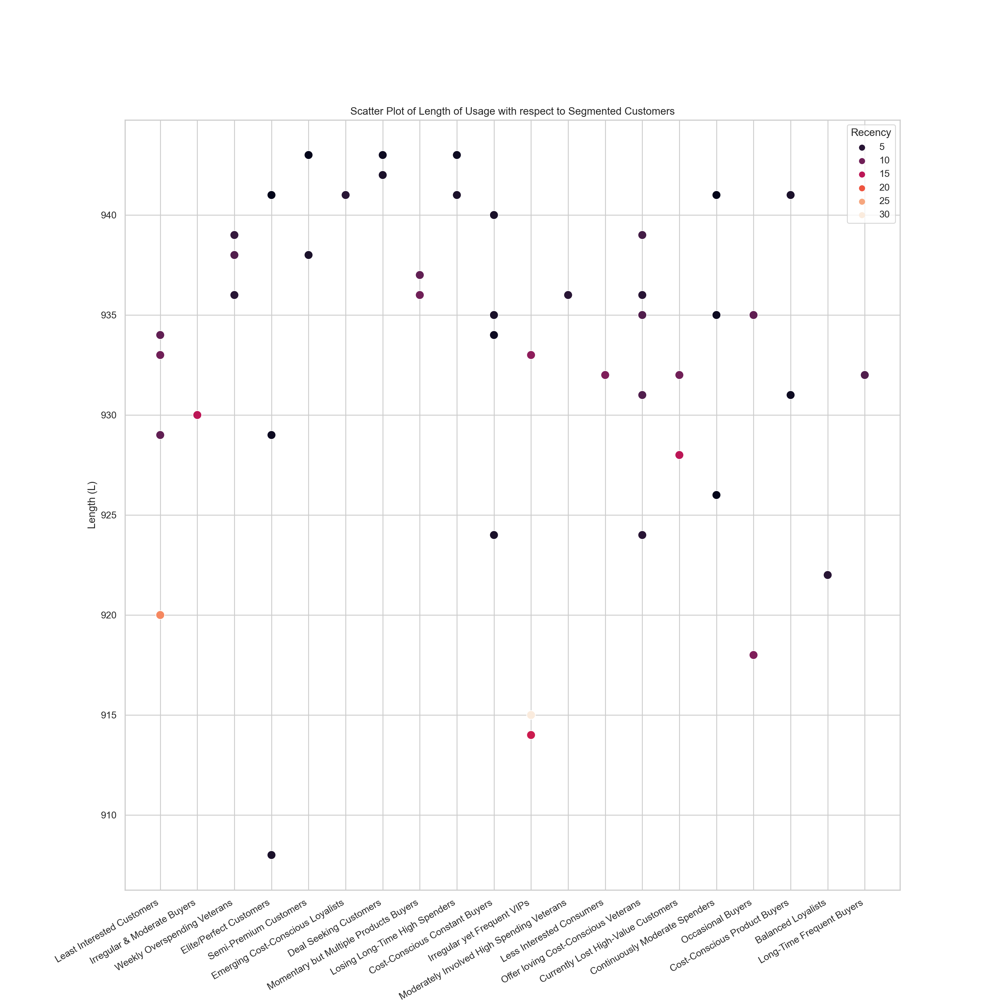

In [61]:
# Set the size of the plot
plt.figure(figsize=(16, 16))

# Scatter plot with 'F' and 'M' as axes, color by 'Conclusion_DBSCAN'
scatter = sns.scatterplot(x='Conclusion_DBSCAN', y='Length', hue='Recency', data=LRFM, palette='rocket', s=100)

# Rotate x-axis labels to the right by 45 degrees
plt.xticks(rotation=30, ha='right')

# Set plot title and labels
plt.title('Scatter Plot of Length of Usage with respect to Segmented Customers')
plt.xlabel('Segmented Customers')
plt.ylabel('Length (L)')

# Show the plot
plt.show()

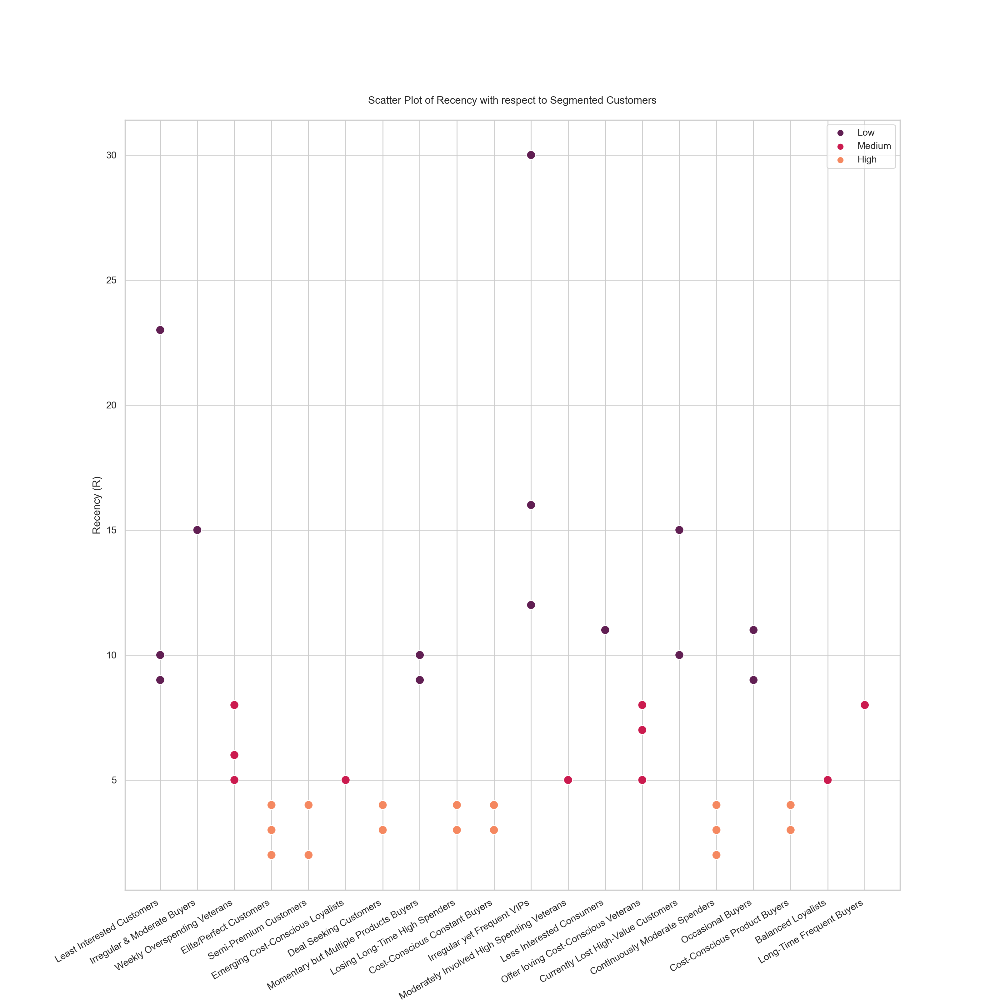

In [62]:
# Set the size of the plot
plt.figure(figsize=(16, 16))

# Scatter plot with 'Conclusion_DBSCAN' and 'Recency' as axes, color by 'StatusR'
scatter = sns.scatterplot(x='Conclusion_DBSCAN', y='Recency', hue='StatusR', data=LRFM, palette='rocket', s=100)

# Rotate x-axis labels to the right by 45 degrees
plt.xticks(rotation=30, ha='right')

# Set plot title and labels
plt.title('Scatter Plot of Recency with respect to Segmented Customers\n')
plt.xlabel('Segmented Customers')
plt.ylabel('Recency (R)')

# Hide the legend title
scatter.legend().set_title('')

# Annotate each point with the count
for p in scatter.patches:
    count = LRFM[2]['Conclusion_DBSCAN'].value_counts()[p.get_label()]
    plt.annotate(f'{count}', (p.get_x() + p.get_width() / 2., p.get_height()),
                 ha='center', va='center', fontsize=12, color='black', xytext=(0, 10),
                 textcoords='offset points')

# Show the plot
plt.show()

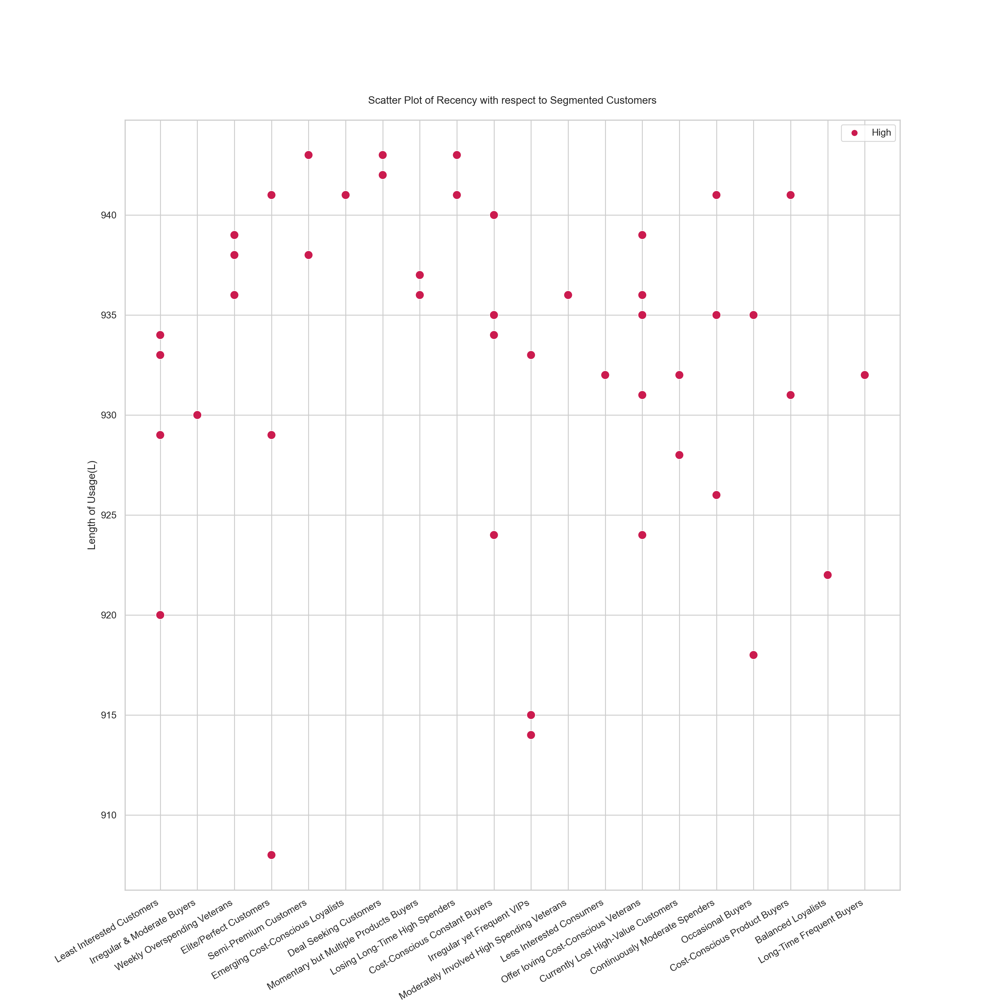

In [63]:
# Set the size of the plot
plt.figure(figsize=(16, 16))

# Scatter plot with 'Conclusion_DBSCAN' and 'Recency' as axes, color by 'StatusR'
scatter = sns.scatterplot(x='Conclusion_DBSCAN', y='Length', hue='StatusL', data=LRFM, palette='rocket', s=100)

# Rotate x-axis labels to the right by 45 degrees
plt.xticks(rotation=30, ha='right')

# Set plot title and labels
plt.title('Scatter Plot of Recency with respect to Segmented Customers\n')
plt.xlabel('Segmented Customers')
plt.ylabel('Length of Usage(L)')

# Hide the legend title
scatter.legend().set_title('')

# Annotate each point with the count
for p in scatter.patches:
    count = LRFM[2]['Conclusion_DBSCAN'].value_counts()[p.get_label()]
    plt.annotate(f'{count}', (p.get_x() + p.get_width() / 2., p.get_height()),
                 ha='center', va='center', fontsize=12, color='black', xytext=(0, 10),
                 textcoords='offset points')

# Show the plot
plt.show()

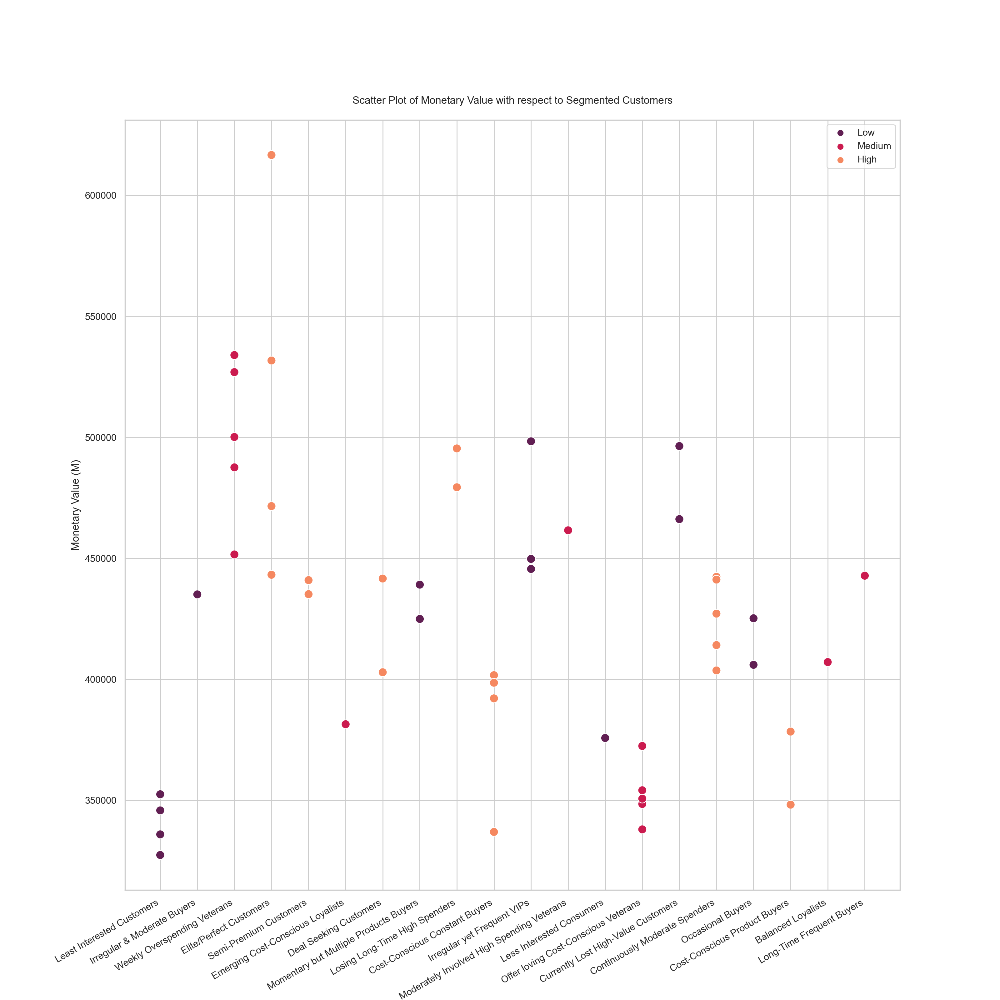

In [64]:
# Set the size of the plot
plt.figure(figsize=(16, 16))

# Scatter plot with 'Conclusion_DBSCAN' and 'Recency' as axes, color by 'StatusR'
scatter = sns.scatterplot(x='Conclusion_DBSCAN', y='Monetary', hue='StatusR', data=LRFM, palette='rocket', s=100)

# Rotate x-axis labels to the right by 45 degrees
plt.xticks(rotation=30, ha='right')

# Set plot title and labels
plt.title('Scatter Plot of Monetary Value with respect to Segmented Customers\n')
plt.xlabel('Segmented Customers')
plt.ylabel('Monetary Value (M)')

# Hide the legend title
scatter.legend().set_title('')

# Annotate each point with the count
for p in scatter.patches:
    count = LRFM[2]['Conclusion_DBSCAN'].value_counts()[p.get_label()]
    plt.annotate(f'{count}', (p.get_x() + p.get_width() / 2., p.get_height()),
                 ha='center', va='center', fontsize=12, color='black', xytext=(0, 10),
                 textcoords='offset points')

# Show the plot
plt.show()

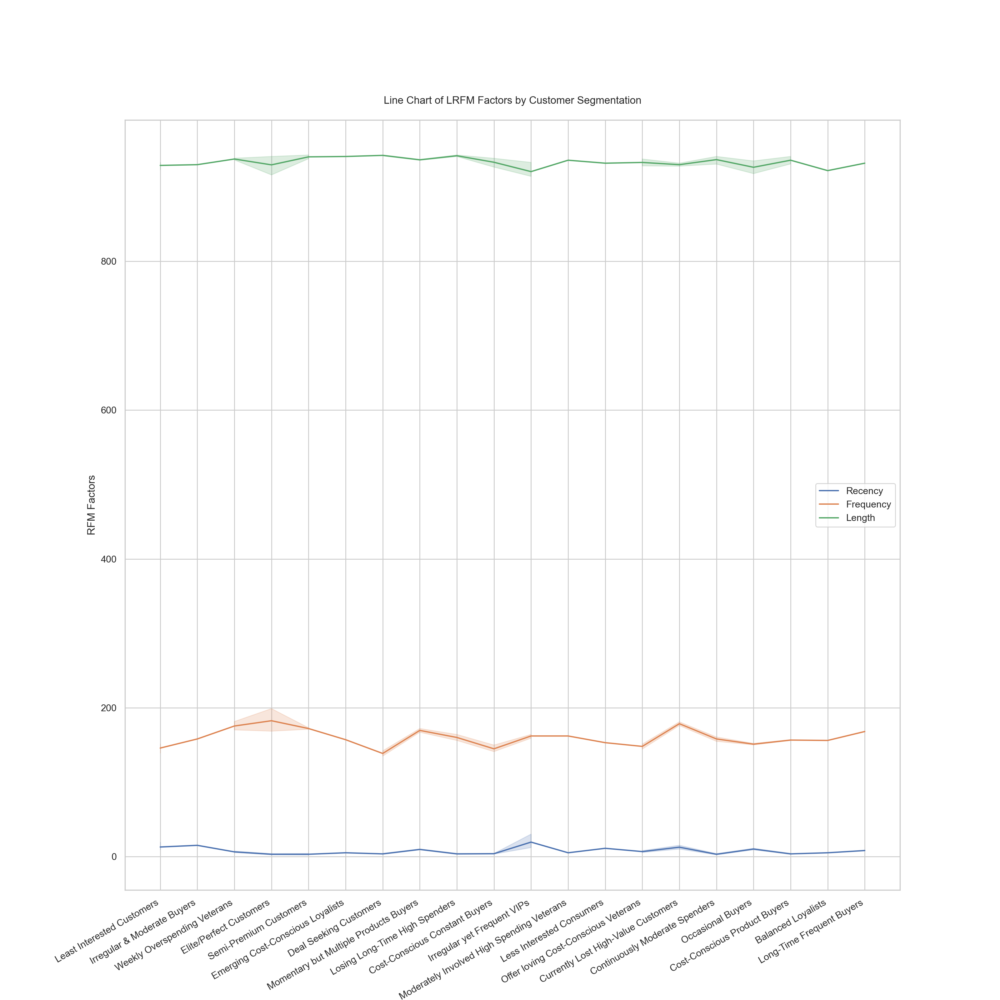

In [65]:
# Set the size of the plot
plt.figure(figsize=(16, 16))

# Line chart for 'Recency' by 'Conclusion_DBSCAN'
sns.lineplot(x='Conclusion_DBSCAN', y='Recency', data=LRFM, label='Recency')

# Line chart for 'Frequency' by 'Conclusion_DBSCAN'
sns.lineplot(x='Conclusion_DBSCAN', y='Frequency', data=LRFM, label='Frequency')

# Line chart for 'Length' by 'Conclusion_DBSCAN'
sns.lineplot(x='Conclusion_DBSCAN', y='Length', data=LRFM, label='Length')

# Set plot title and labels
plt.title('Line Chart of LRFM Factors by Customer Segmentation\n')
plt.xlabel('Segmented Customers')
plt.ylabel('RFM Factors')

# Show the legend
plt.legend()

# Rotate x-axis labels to the right by 45 degrees
plt.xticks(rotation=30, ha='right')

# Show the plot
plt.show()

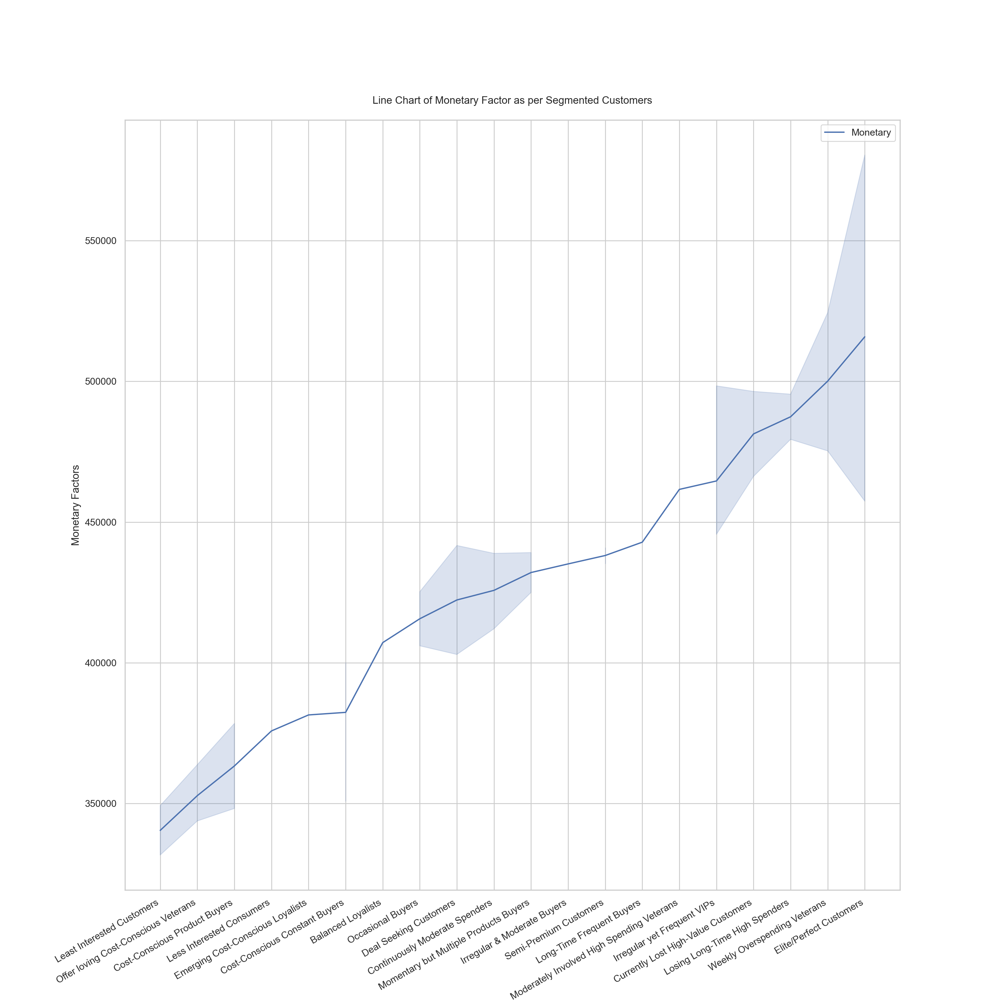

In [66]:
# Order 'Conclusion_DBSCAN' based on mean 'Monetary' value
order = LRFM.groupby('Conclusion_DBSCAN')['Monetary'].mean().sort_values().index

# Sort the DataFrame based on the order
sorted_df = LRFM.set_index('Conclusion_DBSCAN').loc[order].reset_index()

# Set the size of the plot
plt.figure(figsize=(16, 16))

# Line chart for 'Monetary' by 'Conclusion_DBSCAN'
sns.lineplot(x='Conclusion_DBSCAN', y='Monetary', data=sorted_df, label='Monetary')

# Set plot title and labels
plt.title('Line Chart of Monetary Factor as per Segmented Customers\n')
plt.xlabel('Segmented Customers')
plt.ylabel('Monetary Factors')

# Show the legend
plt.legend()

# Rotate x-axis labels to the right by 45 degrees
plt.xticks(rotation=30, ha='right')

# Show the plot
plt.show()

In [67]:
# Set the size of the plot
plt.figure(figsize=(50, 40))

# Create a DataFrame for the violin plot
df_violin = pd.melt(LRFM, id_vars='Conclusion_DBSCAN', value_vars=['Recency', 'Frequency', 'Length'])

# Plot the violin chart
ax = sns.violinplot(x='variable', y='value', hue='Conclusion_DBSCAN', data=df_violin, palette='tab20')

# Set plot title and labels
plt.title('Violin Plot of Customer Segmentation based on LRFM Factors\n', fontsize=40)
plt.xlabel('\n\nLRFM Factors', fontsize=40)
plt.ylabel('Data', fontsize=40)

# Increase the size of the legend
ax.legend(loc='upper left', bbox_to_anchor=(1, 1), prop={'size': 40})

ax.tick_params(axis='both', labelsize=40)

# Show the plot
plt.show()

In [68]:
# Set the size of the plot
plt.figure(figsize=(40, 40))

# Create a DataFrame for the violin plot
df_violin = pd.melt(LRFM, id_vars='Conclusion_DBSCAN', value_vars=['Monetary'])

# Plot the violin chart
ax = sns.violinplot(x='variable', y='value', hue='Conclusion_DBSCAN', data=df_violin, palette='tab20')

# Set plot title and labels
plt.title('Violin Plot of Customer Segmentation based on Monetary Factors\n', fontsize=40)
plt.ylabel('Amount', fontsize=40)

# Increase the size of the legend
ax.legend(loc='upper left', bbox_to_anchor=(1, 1), prop={'size': 40})

ax.tick_params(axis='both', labelsize=40)

# Show the plot
plt.show()

In [69]:
# Assuming 'Recency', 'Frequency', 'Monetary' are columns in LRFM[2]
fig = px.scatter(
    LRFM,
    x='StatusR',
    y='Frequency',
    size='Monetary',  # Bubble size represents Monetary value
    color='Length',  # Color represents Recency
    hover_name=LRFM.index,  # Customer ID as hover information
    title='Bubble Chart for Customer Segmentation',
    labels={'Length': 'Length of Usage (L)','StatusR': 'Recency (R)', 'Frequency': 'Frequency (F)', 'Monetary': 'Monetary (M)'}
)

# Show the plot
fig.show()

In [70]:
# Assuming 'Recency', 'Frequency', 'Monetary' are columns in LRFM[2]
fig = px.scatter(
    LRFM,
    x='StatusF',
    y='Monetary',
    size='Recency',  # Bubble size represents Monetary value
    color='Length',  # Color represents Recency
    hover_name=LRFM.index,  # Customer ID as hover information
    title='Bubble Chart for Customer Segmentation',
    labels={'Length': 'Length of Usage (L)','Recency': 'Recency (R)', 'StatusF': 'Frequency (F)', 'Monetary': 'Monetary (M)'}
)

# Show the plot
fig.show()

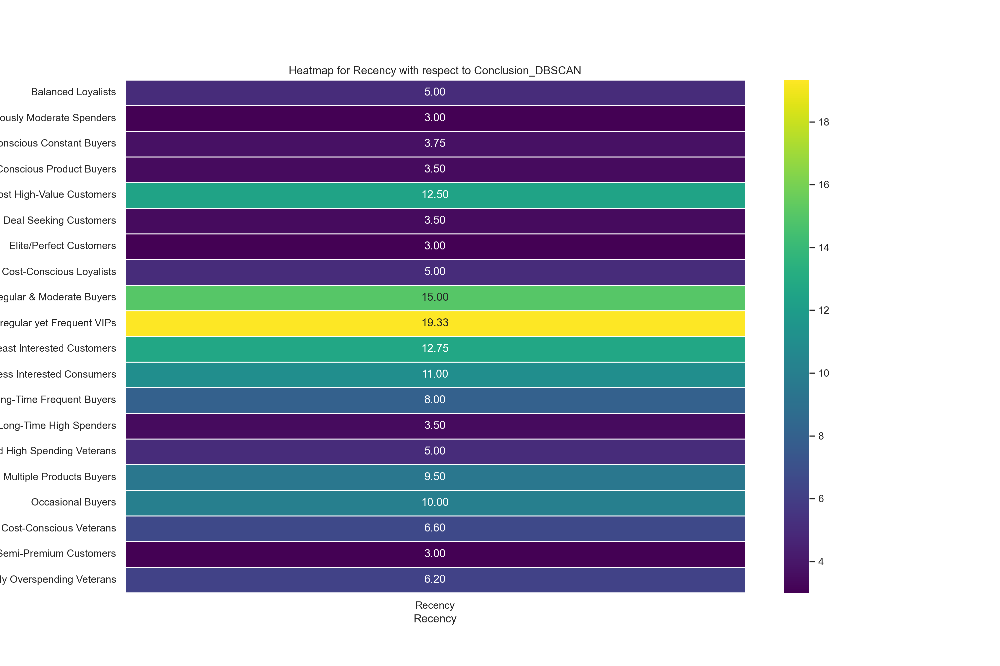

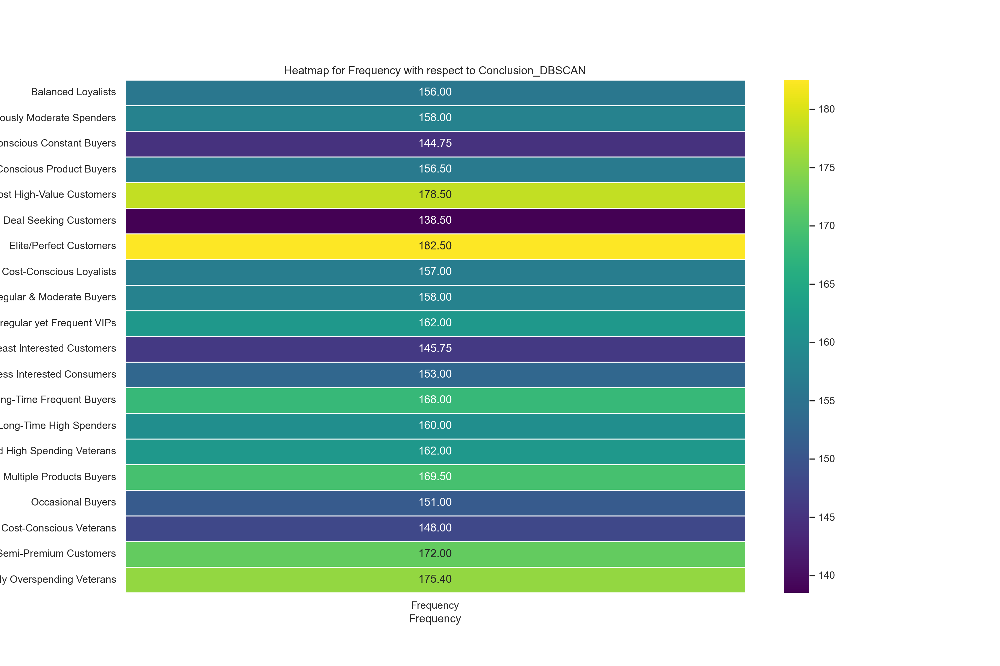

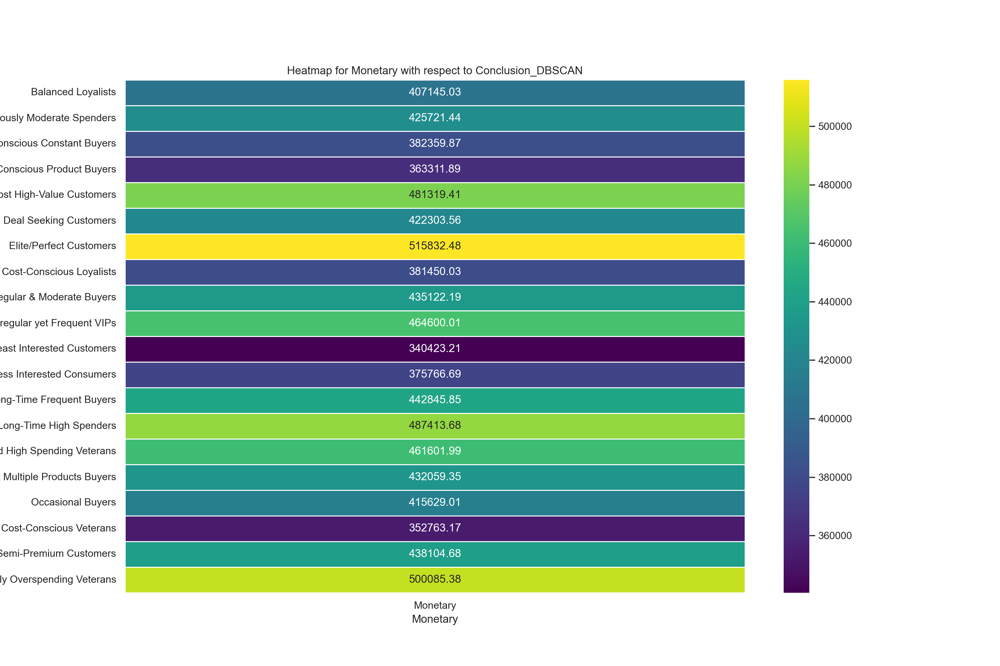

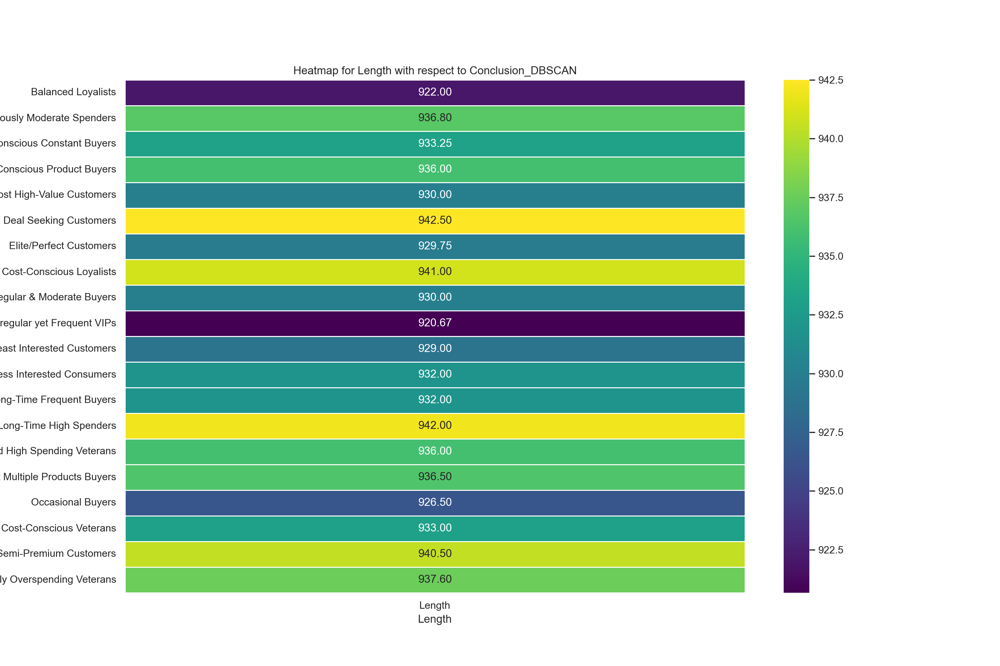

In [71]:
# Extract relevant columns for the heatmap
heatmap_data = LRFM[['Recency', 'Frequency', 'Monetary', 'Length', 'Conclusion_DBSCAN']]

# Set the style for better visualization (optional)
sns.set(style="whitegrid")

# Create a separate heatmap for each variable
for column in ['Recency', 'Frequency', 'Monetary', 'Length']:
    plt.figure(figsize=(15, 10))
    heatmap_df = heatmap_data.pivot_table(index='Conclusion_DBSCAN', values=column, aggfunc='mean')
    sns.heatmap(heatmap_df, annot=True, cmap='viridis', fmt=".2f", linewidths=.5)
    plt.title(f'Heatmap for {column} with respect to Conclusion_DBSCAN')
    plt.xlabel(column)
    plt.ylabel('Conclusion_DBSCAN')
    plt.show()


In [72]:
X1 = features_df1[['Recency_before_180_days_of_cutoff', 'Frequency_before_180_days_of_cutoff', 'Monetary_before_180_days_of_cutoff', 'Average_Money_before_180_days_of_cutoff']]
X1

,Recency_before_180_days_of_cutoff,Frequency_before_180_days_of_cutoff,Monetary_before_180_days_of_cutoff,Average_Money_before_180_days_of_cutoff
_CustomerID,,,,
1,8,36,94401.5260,2210.089549
10,1,31,68190.4895,2753.937892
11,5,34,95288.6730,2739.405851
12,4,52,176050.7410,2936.758357
13,3,22,66252.5145,2578.966547
14,4,27,47071.5200,2429.618013
15,31,32,115080.7410,3110.340528
16,14,24,71293.9965,2984.731633
17,2,35,114526.7850,3051.585063


In [73]:
#NEXT 90 DAYS VALUE

y_spend = features_df1[['Spent_last_30']]

xgb_reg_spec1 = XGBRegressor (
    objective = "reg:squarederror",
    random_state = 123
)

xgb_reg_model1 = GridSearchCV(
    estimator = xgb_reg_spec1,
    param_grid = dict (
        learning_rate = [0.01, 0.1, 0.3, 0.5]
    ),
    
scoring = 'neg_mean_absolute_error',
refit = True,
cv = 5
)

In [74]:
xgb_reg_model1.fit(X1, y_spend)

GridSearchCV(cv=5,
             estimator=XGBRegressor(base_score=None, booster=None,
                                    callbacks=None, colsample_bylevel=None,
                                    colsample_bynode=None,
                                    colsample_bytree=None, device=None,
                                    early_stopping_rounds=None,
                                    enable_categorical=False, eval_metric=None,
                                    feature_types=None, gamma=None,
                                    grow_policy=None, importance_type=None,
                                    interaction_constraints=None,
                                    learning_rate=None, max_bin=None,
                                    max_cat_threshold=None,
                                    max_cat_to_onehot=None, max_delta_step=None,
                                    max_depth=None, max_leaves=None,
                                    min_child_weight=None, missing=nan,
                                    monotone_constraints=None,
                                    multi_strategy=None, n_estimators=None,
                                    n_jobs=None, num_parallel_tree=None,
                                    random_state=123, ...),
             param_grid={'learning_rate': [0.01, 0.1, 0.3, 0.5]},
             scoring='neg_mean_absolute_error')

In [75]:
xgb_reg_model1.best_score_  

-20905.915060625004

In [76]:
xgb_reg_model1.__dict__

{'scoring': 'neg_mean_absolute_error',
 'estimator': XGBRegressor(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, random_state=123, ...),
 'n_jobs': None,
 'refit': True,
 'cv': 5,
 'verbose': 0,
 'pre_dispatch': '2*n_jobs',
 'error_score': nan,
 'return_train_score': False,
 'param_grid': {'learning_rate': [0.01, 0.1, 0.3, 0.

In [77]:
xgb_reg_model1.best_params_

{'learning_rate': 0.01}

In [78]:
xgb_reg_model1.best_estimator_

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.01, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=None, n_jobs=None,
             num_parallel_tree=None, random_state=123, ...)

In [79]:
predictions_reg1 = xgb_reg_model1.predict(X1)
predictions_reg1

array([ 55780.5  ,  92024.984,  93323.71 ,  97402.05 ,  83250.63 ,
        87334.19 ,  98763.12 ,  78375.48 ,  72585.62 ,  93369.71 ,
        72811.44 ,  76208.164,  62135.484,  77100.55 ,  76162.69 ,
        93323.71 ,  55780.5  ,  84111.   ,  81388.76 ,  64731.54 ,
        76208.164,  77600.35 ,  72687.195,  93323.71 ,  64691.473,
        70221.59 ,  95810.74 ,  82438.875,  66626.125,  72843.234,
        80209.72 ,  64731.54 ,  78091.51 ,  96613.83 ,  65571.086,
        68004.95 ,  79155.63 ,  93369.71 ,  77447.74 ,  63709.95 ,
        74060.47 ,  71501.8  ,  80057.59 ,  55780.5  ,  68155.72 ,
       101351.99 ,  92170.46 ,  82008.37 ,  57217.37 ,  96218.79 ],
      dtype=float32)

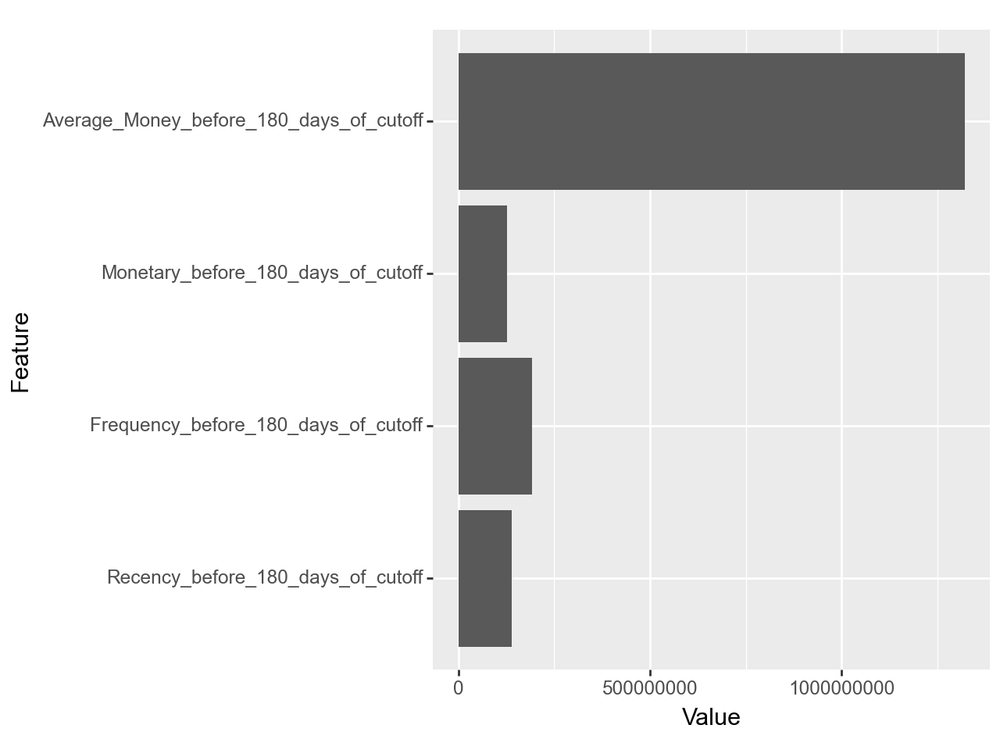

In [80]:
# Extract feature importance values from the XGBoost regression model
imp_spend_amount_dict = xgb_reg_model1.best_estimator_.get_booster().get_score(importance_type='gain')

# Create a DataFrame to store feature names and their corresponding importance values
imp_spend_amount_df = pd.DataFrame({
    'Feature': list(imp_spend_amount_dict.keys()),
    'Value': list(imp_spend_amount_dict.values())
}).assign(
    Feature=lambda x: pd.Categorical(x['Feature'], categories=x['Feature'], ordered=True)
)

# Create a ggplot visualization using Plotnine
plot = (
    pn.ggplot(imp_spend_amount_df, pn.aes('Feature', 'Value'))
    + pn.geom_col()
    + pn.coord_flip()
)

# Display the plot
plot.draw()


In [81]:
predictions_df1 = pd.concat(
    [ 
        pd.DataFrame(predictions_reg1).set_axis(['pred_spend'], axis = 1),
#         pd.Dataframe(predictions_clf)[[1]].set_axis([‘pred_prob’], axis = 1),
        features_df1.reset_index()
    ],
    axis = 1
)

predictions_df1


,pred_spend,_CustomerID,Recency_before_180_days_of_cutoff,Frequency_before_180_days_of_cutoff,Monetary_before_180_days_of_cutoff,Average_Money_before_180_days_of_cutoff,Spent_last_30,Spent_last_30_flag
0,55780.500000,1,8,36,94401.5260,2210.089549,27930.8595,1
1,92024.984375,10,1,31,68190.4895,2753.937892,98415.2280,1
2,93323.710938,11,5,34,95288.6730,2739.405851,103724.3750,1
3,97402.046875,12,4,52,176050.7410,2936.758357,127688.5665,1
4,83250.632812,13,3,22,66252.5145,2578.966547,90949.0495,1
5,87334.187500,14,4,27,47071.5200,2429.618013,93484.0280,1
6,98763.117188,15,31,32,115080.7410,3110.340528,109837.4550,1
7,78375.476562,16,14,24,71293.9965,2984.731633,79482.8035,1
8,72585.617188,17,2,35,114526.7850,3051.585063,63041.2380,1
9,93369.710938,18,1,36,88786.2560,2428.159968,116760.9670,1


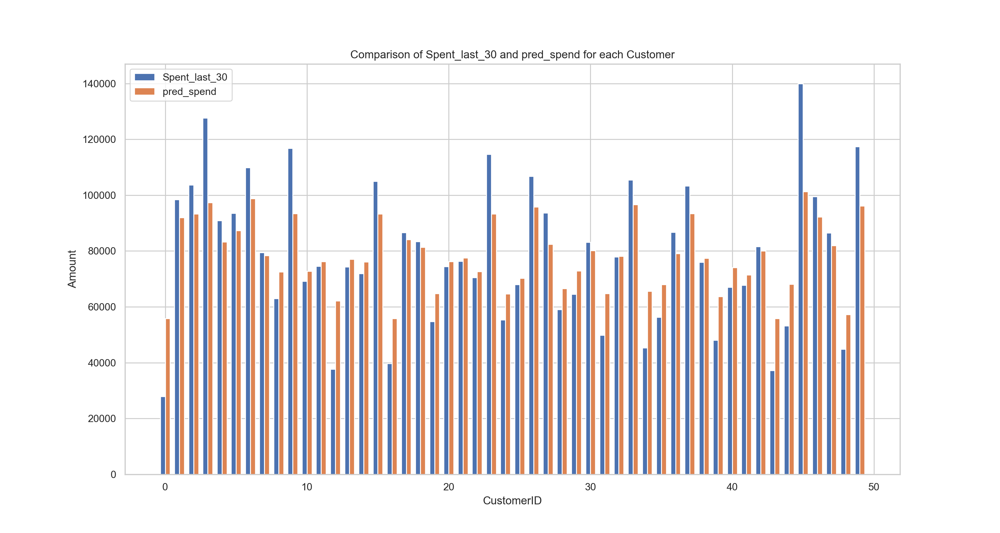

In [82]:
# Set the style for better visualization
sns.set(style="whitegrid")

# Create a bar chart
plt.figure(figsize=(15, 8))
bar_width = 0.35

# Plot the 'Spent_last_30'
plt.bar(predictions_df1.index - bar_width / 2, predictions_df1['Spent_last_30'], bar_width, label='Spent_last_30')

# Plot the 'pred_spend'
plt.bar(predictions_df1.index + bar_width / 2, predictions_df1['pred_spend'], bar_width, label='pred_spend')

# Set labels and title
plt.xlabel('CustomerID')
plt.ylabel('Amount')
plt.title('Comparison of Spent_last_30 and pred_spend for each Customer')
plt.legend()

# Show the plot
plt.show()

In [83]:
X = features_df[['Recency_before_last_30_days', 'Frequency_before_last_30_days', 'Monetary_before_last_30_days', 'Average_Money_before_last_30_days']]
X

,Recency_before_last_30_days,Frequency_before_last_30_days,Monetary_before_last_30_days,Average_Money_before_last_30_days
_CustomerID,,,,
1,8,125,308002.7520,2210.089549
10,1,123,336706.9590,2753.937892
11,5,145,383889.8665,2739.405851
12,4,164,489030.6885,2936.758357
13,3,139,350054.2300,2578.966547
14,4,126,287966.0000,2429.618013
15,31,112,331830.9000,3110.340528
16,14,101,323455.9670,2984.731633
17,2,150,470986.1480,3051.585063


In [84]:
#NEXT 180 DAYS VALUE

y_spend1 = features_df[['Spent_last_30']]

xgb_reg_spec = XGBRegressor (
    objective = "reg:squarederror",
    random_state = 123
)

xgb_reg_model = GridSearchCV(
    estimator = xgb_reg_spec,
    param_grid = dict (
        learning_rate = [0.01, 0.1, 0.3, 0.5]
    ),
    
scoring = 'neg_mean_absolute_error',
refit = True,
cv = 5
)

In [85]:
xgb_reg_model.fit(X, y_spend1)

GridSearchCV(cv=5,
             estimator=XGBRegressor(base_score=None, booster=None,
                                    callbacks=None, colsample_bylevel=None,
                                    colsample_bynode=None,
                                    colsample_bytree=None, device=None,
                                    early_stopping_rounds=None,
                                    enable_categorical=False, eval_metric=None,
                                    feature_types=None, gamma=None,
                                    grow_policy=None, importance_type=None,
                                    interaction_constraints=None,
                                    learning_rate=None, max_bin=None,
                                    max_cat_threshold=None,
                                    max_cat_to_onehot=None, max_delta_step=None,
                                    max_depth=None, max_leaves=None,
                                    min_child_weight=None, missing=nan,
                                    monotone_constraints=None,
                                    multi_strategy=None, n_estimators=None,
                                    n_jobs=None, num_parallel_tree=None,
                                    random_state=123, ...),
             param_grid={'learning_rate': [0.01, 0.1, 0.3, 0.5]},
             scoring='neg_mean_absolute_error')

In [86]:
xgb_reg_model.best_score_  

-18097.613053125002

In [87]:
xgb_reg_model.best_params_

{'learning_rate': 0.01}

In [88]:
xgb_reg_model.best_estimator_

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.01, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=None, n_jobs=None,
             num_parallel_tree=None, random_state=123, ...)

In [89]:
predictions_reg = xgb_reg_model.predict(X)
predictions_reg

array([ 56572.56 ,  92024.984,  93323.71 ,  97819.41 ,  83335.59 ,
        87947.8  ,  96819.625,  79240.66 ,  72648.38 ,  93273.94 ,
        67656.56 ,  76208.164,  62345.965,  78578.72 ,  74462.695,
        93323.71 ,  56572.56 ,  83727.82 ,  81133.04 ,  64139.055,
        76208.164,  74433.28 ,  73521.51 ,  93323.71 ,  62345.965,
        72165.85 ,  94745.37 ,  82633.59 ,  66464.18 ,  70941.22 ,
        80006.45 ,  58304.605,  78194.17 ,  95544.97 ,  67656.56 ,
        70175.63 ,  81687.7  ,  93273.94 ,  77447.74 ,  62345.965,
        74060.47 ,  67656.56 ,  79631.44 ,  56572.56 ,  69887.13 ,
       101793.016,  92170.46 ,  82008.37 ,  58304.605,  97061.63 ],
      dtype=float32)

In [90]:
# y_prob = features_df[['Spent_last_30_flag']]

# xgb_clf_spec = XGBClassifier(
#     objective="binary:logistic",
#     random_state=123
# )

# xgb_clf_model = GridSearchCV(
#     estimator=xgb_clf_spec,
#     param_grid=dict(
#         learning_rate=[0.01, 0.1, 0.3, 0.5]
#     ),
#     scoring='roc_auc',
#     refit=True,
#     cv=5
# )

In [91]:
# xgb_clf_model.fit(X, y_prob)

In [92]:
# xgb_clf_model.best_score_


In [93]:
# xgb_clf_model.best_params_


In [94]:
# xgb_clf_model.best_estimator_


In [95]:
# predictions_clf = xgb_clf_model.predict_proba(X)


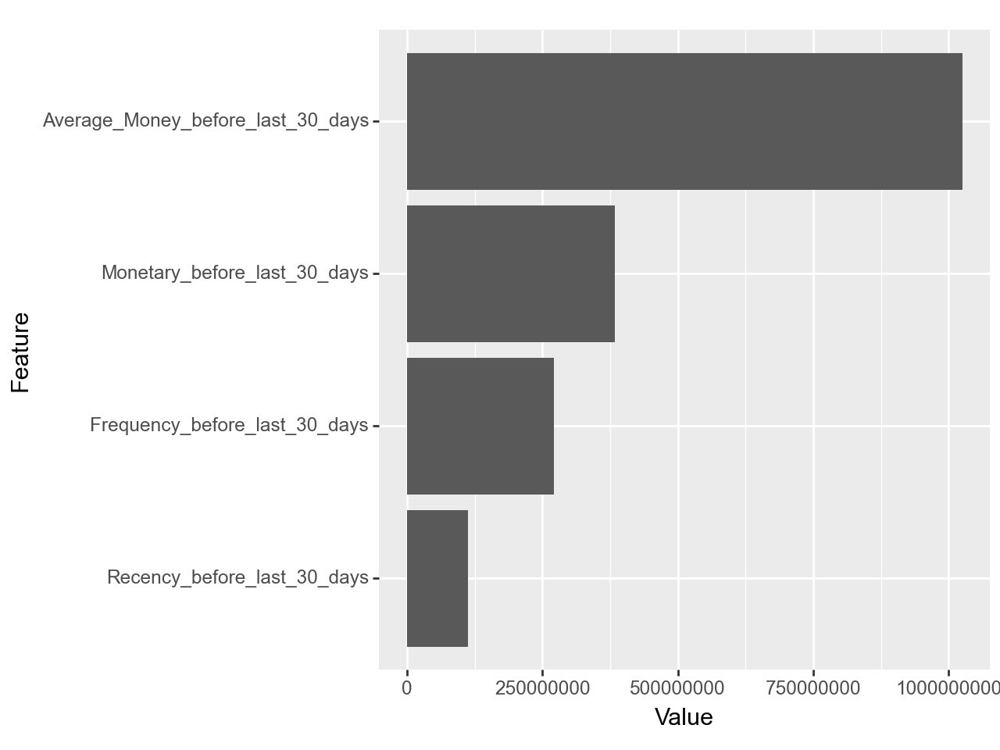

In [96]:
# Extract feature importance values from the XGBoost regression model
imp_spend_amount_dict = xgb_reg_model.best_estimator_.get_booster().get_score(importance_type='gain')

# Create a DataFrame to store feature names and their corresponding importance values
imp_spend_amount_df = pd.DataFrame({
    'Feature': list(imp_spend_amount_dict.keys()),
    'Value': list(imp_spend_amount_dict.values())
}).assign(
    Feature=lambda x: pd.Categorical(x['Feature'], categories=x['Feature'], ordered=True)
)

# Create a ggplot visualization using Plotnine
plot = (
    pn.ggplot(imp_spend_amount_df, pn.aes('Feature', 'Value'))
    + pn.geom_col()
    + pn.coord_flip()
)

# Display the plot
plot.draw()


In [97]:
predictions_df = pd.concat(
    [ 
        pd.DataFrame(predictions_reg).set_axis(['pred_spend'], axis = 1),
#         pd.Dataframe(predictions_clf)[[1]].set_axis([‘pred_prob’], axis = 1),
        features_df.reset_index()
    ],
    axis = 1
)

predictions_df


,pred_spend,_CustomerID,Recency_before_last_30_days,Frequency_before_last_30_days,Monetary_before_last_30_days,Average_Money_before_last_30_days,Spent_last_30,Spent_last_30_flag
0,56572.558594,1,8,125,308002.7520,2210.089549,27930.8595,1
1,92024.984375,10,1,123,336706.9590,2753.937892,98415.2280,1
2,93323.710938,11,5,145,383889.8665,2739.405851,103724.3750,1
3,97819.406250,12,4,164,489030.6885,2936.758357,127688.5665,1
4,83335.593750,13,3,139,350054.2300,2578.966547,90949.0495,1
5,87947.796875,14,4,126,287966.0000,2429.618013,93484.0280,1
6,96819.625000,15,31,112,331830.9000,3110.340528,109837.4550,1
7,79240.656250,16,14,101,323455.9670,2984.731633,79482.8035,1
8,72648.382812,17,2,150,470986.1480,3051.585063,63041.2380,1
9,93273.937500,18,1,141,334876.7870,2428.159968,116760.9670,1


In [98]:
# #Missed Opportunities: Big spenders that could be unlocked –
# -Send bundle offers encouraging volume purchases
# - Focus on missed opportunities

# predictions_df \
# [
# predictions_df['spend_90_total'] == 0.0
# ] \


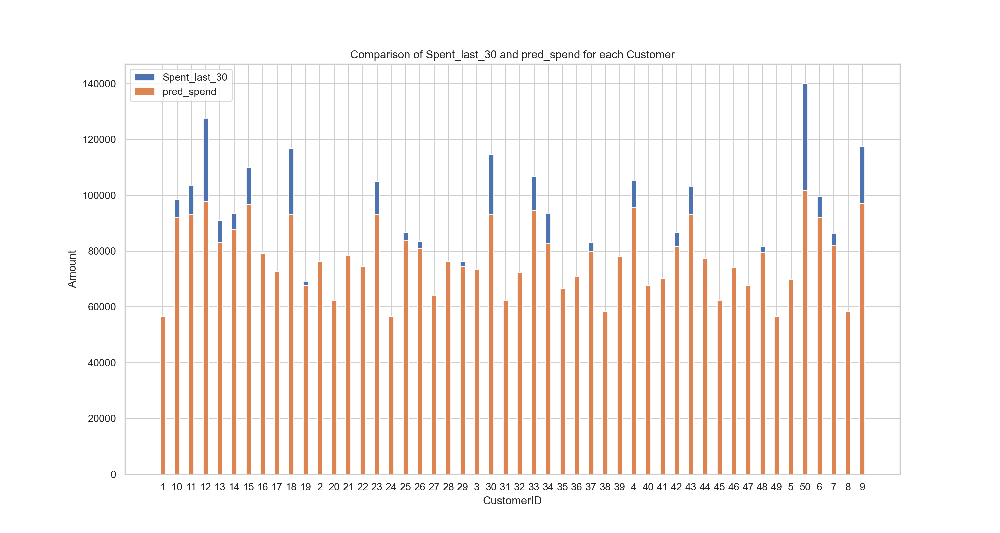

In [99]:
# Set the style for better visualization
sns.set(style="whitegrid")

# Create a bar chart
plt.figure(figsize=(15, 8))
bar_width = 0.35

# Plot the 'Spent_last_30'
plt.bar(predictions_df['_CustomerID'], predictions_df['Spent_last_30'], bar_width, label='Spent_last_30')

# Plot the 'pred_spend'
plt.bar(predictions_df['_CustomerID'], predictions_df['pred_spend'], bar_width, label='pred_spend')

# Set labels and title
plt.xlabel('CustomerID')
plt.ylabel('Amount')
plt.title('Comparison of Spent_last_30 and pred_spend for each Customer')
plt.legend()

# Show the plot
plt.show()

In [100]:
# # Columns names:
# a = 'Average_Money_before_180_days_of_cutoff'
# b = 'Monetary_before_180_days_of_cutoff'
# c = 'Frequency_before_180_days_of_cutoff'
# d = 'Recency_before_180_days_of_cutoff'

# x = X1[a].to_numpy().reshape(-1,1)
# y = y_spend2.to_numpy()

NameError: name 'y_spend2' is not defined

In [101]:
model = LinearRegression().fit(x,y)

In [102]:
import matplotlib.pyplot as plt

slope = model.coef_
intercept = model.intercept_

def mapping(x):
    return slope*x + intercept

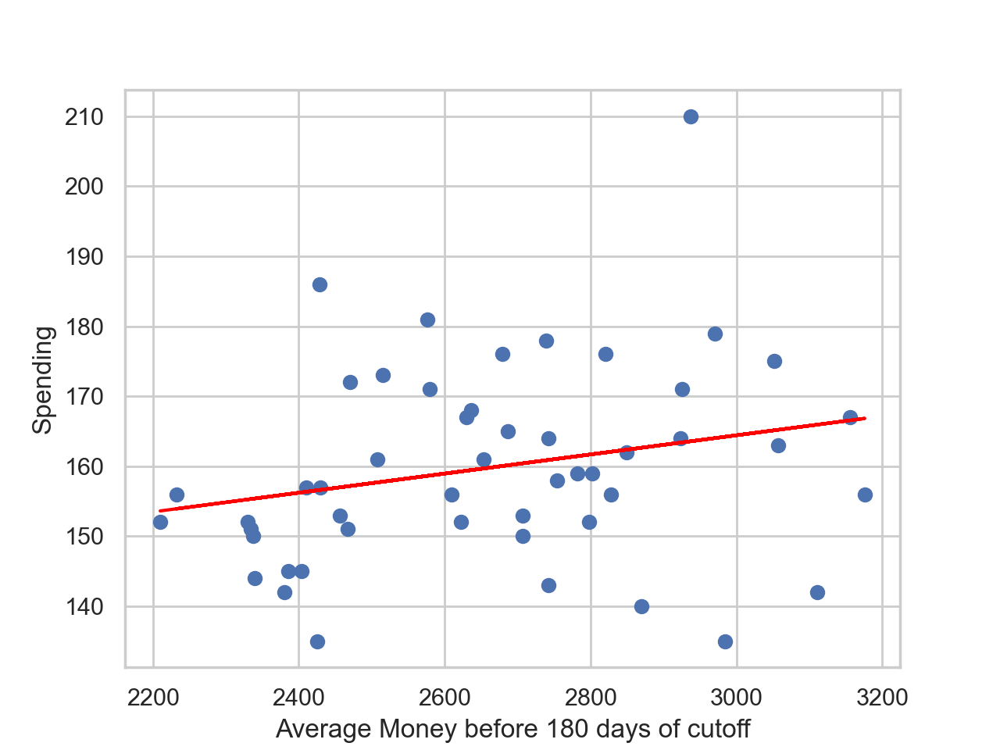

In [103]:
plt.scatter(x,y)
plt.xlabel("Average Money before 180 days of cutoff")
plt.ylabel("Spending")
plt.plot(x,list(map(mapping, x)), 'red')

In [104]:
model.score(x,y)

0.058370521426046484

In [105]:
from sklearn.model_selection import cross_val_predict

y_spend2 = features_df1['Spent_last_30']

# Creating the Linear Regression model
ols_model = LinearRegression()

# Performing cross-validated predictions
predicted_values = cross_val_predict(ols_model, X1, y_spend2, cv=5)

# Displaying the predicted values
print('Predicted Values:')
print(predicted_values)

Predicted Values:
[ 43386.19157141  83077.64887694  77310.5225889   71411.37280216
  74893.45056342  67307.51937628 101672.35361765 100930.29595411
  93432.50534658  57394.54610392  79451.97756698  64800.27583943
  78057.62339478  97799.12279865  89157.34877751  78073.88061357
  64216.9391057   94433.84332846  60823.56345772  63774.58940558
  63747.25215152 100050.82218539  64262.76318323  88152.36637856
  79215.82076312  79213.12282914 106986.17655634  86142.26662957
  63878.9883178   89931.70263894  88227.92211296  59825.906792
  84326.10669669 109802.35098275  85499.26591948  67105.31338163
  72632.11292834  68757.5268928   52951.67184827  71140.19535277
  67215.14022875  77749.76374898  68261.20087346  62458.24363486
  84040.18332546  94204.22672695  80051.82901923  80011.41821889
  66078.25464737  88297.55400216]


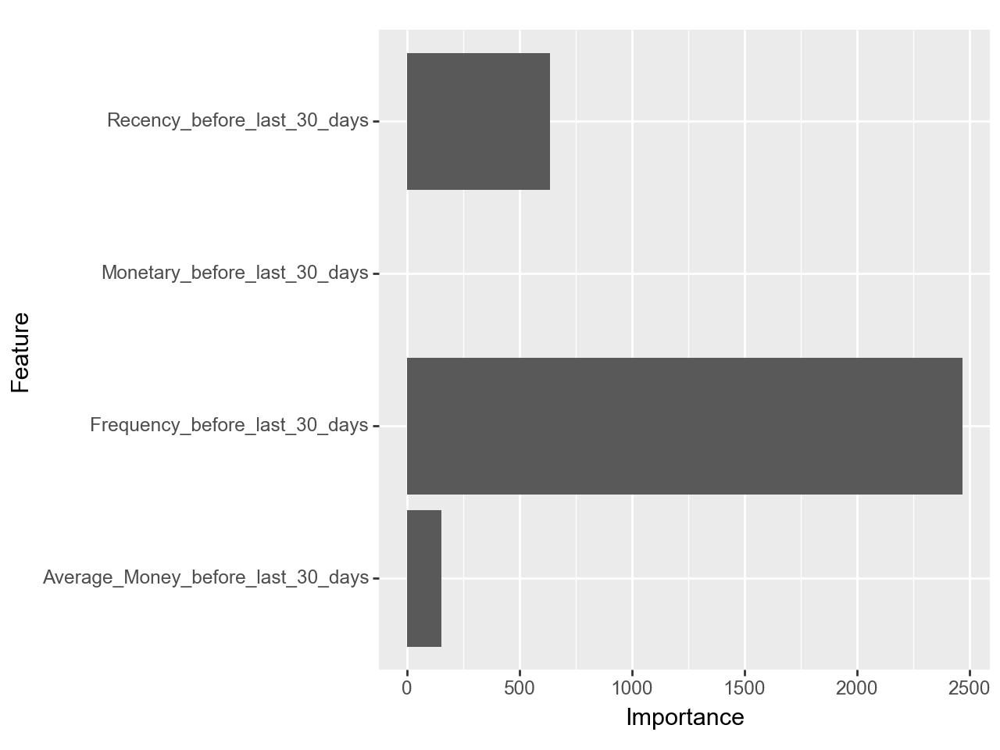

In [106]:

# Fitting the model
ols_model.fit(X, y_spend2)

# Extract feature importances (coefficients)
feature_importances = ols_model.coef_

# Take the absolute values of feature importances
abs_feature_importances = abs(feature_importances)

# Create a DataFrame to store feature names and their corresponding importance values
feature_importance_df = pd.DataFrame({
    'Feature': X.columns,
    'Importance': abs_feature_importances
}).sort_values(by='Importance', ascending=False)

# Create a ggplot visualization using Plotnine
plot = (
    ggplot(feature_importance_df, aes(x='Feature', y='Importance'))
    + geom_col()
    + coord_flip()
)

# Display the plot
plot.draw()

In [107]:
# Extract feature importances (coefficients)
feature_importances = ols_model.coef_

# Displaying the feature importances
print('Feature Importances:')
for feature, importance in zip(X.columns, feature_importances):
    print(f'{feature}: {importance}')

Feature Importances:
Recency_before_last_30_days: -636.3260865393503
Frequency_before_last_30_days: 2468.328130788173
Monetary_before_last_30_days: -0.8615821484654589
Average_Money_before_last_30_days: 153.52900860898598


In [108]:
predictions_df5 = pd.concat(
    [ 
        pd.DataFrame(predicted_values).set_axis(['pred_spend'], axis = 1),
#         pd.Dataframe(predictions_clf)[[1]].set_axis([‘pred_prob’], axis = 1),
        features_df.reset_index()
    ],
    axis = 1
)

predictions_df5

,pred_spend,_CustomerID,Recency_before_last_30_days,Frequency_before_last_30_days,Monetary_before_last_30_days,Average_Money_before_last_30_days,Spent_last_30,Spent_last_30_flag
0,43386.191571,1,8,125,308002.7520,2210.089549,27930.8595,1
1,83077.648877,10,1,123,336706.9590,2753.937892,98415.2280,1
2,77310.522589,11,5,145,383889.8665,2739.405851,103724.3750,1
3,71411.372802,12,4,164,489030.6885,2936.758357,127688.5665,1
4,74893.450563,13,3,139,350054.2300,2578.966547,90949.0495,1
5,67307.519376,14,4,126,287966.0000,2429.618013,93484.0280,1
6,101672.353618,15,31,112,331830.9000,3110.340528,109837.4550,1
7,100930.295954,16,14,101,323455.9670,2984.731633,79482.8035,1
8,93432.505347,17,2,150,470986.1480,3051.585063,63041.2380,1
9,57394.546104,18,1,141,334876.7870,2428.159968,116760.9670,1


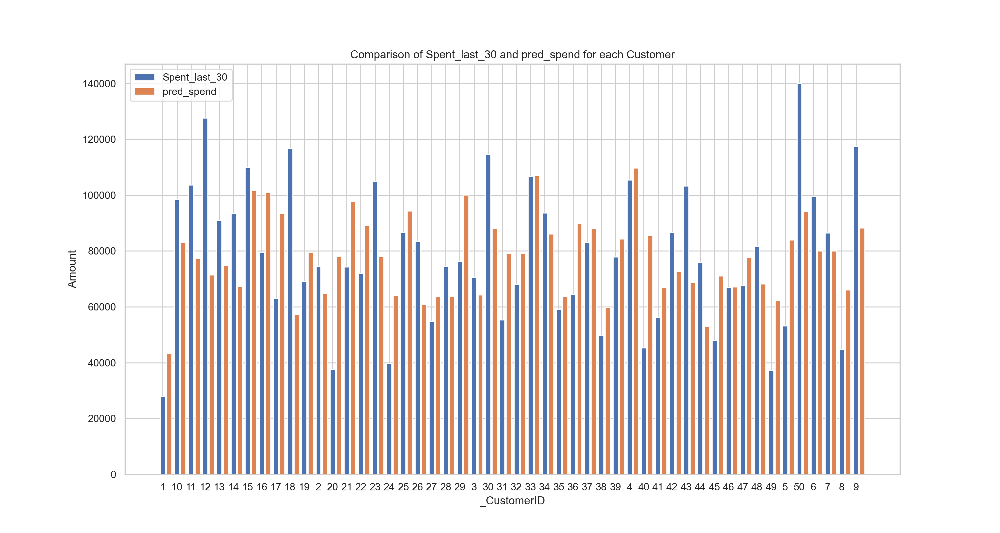

In [109]:
# Set the style for better visualization
sns.set(style="whitegrid")

# Create a bar chart
plt.figure(figsize=(15, 8))
bar_width = 0.35
bar_spacing = 0.1  # Set the desired spacing between bars

# Set x-axis ticks to the values of '_CustomerID'
plt.xticks(range(len(predictions_df5['_CustomerID'])), predictions_df5['_CustomerID'])

# Plot the 'Spent_last_30' on the x-axis with adjusted x-coordinates for spacing
plt.bar(range(len(predictions_df5['_CustomerID'])), predictions_df5['Spent_last_30'], bar_width, label='Spent_last_30')

# Plot the 'pred_spend' on the x-axis with adjusted x-coordinates for spacing
plt.bar([i + (bar_width + bar_spacing) for i in range(len(predictions_df5['_CustomerID']))], predictions_df5['pred_spend'], bar_width, label='pred_spend')

# Set labels and title
plt.xlabel('_CustomerID')
plt.ylabel('Amount')
plt.title('Comparison of Spent_last_30 and pred_spend for each Customer')
plt.legend()

# Show the plot
plt.show()

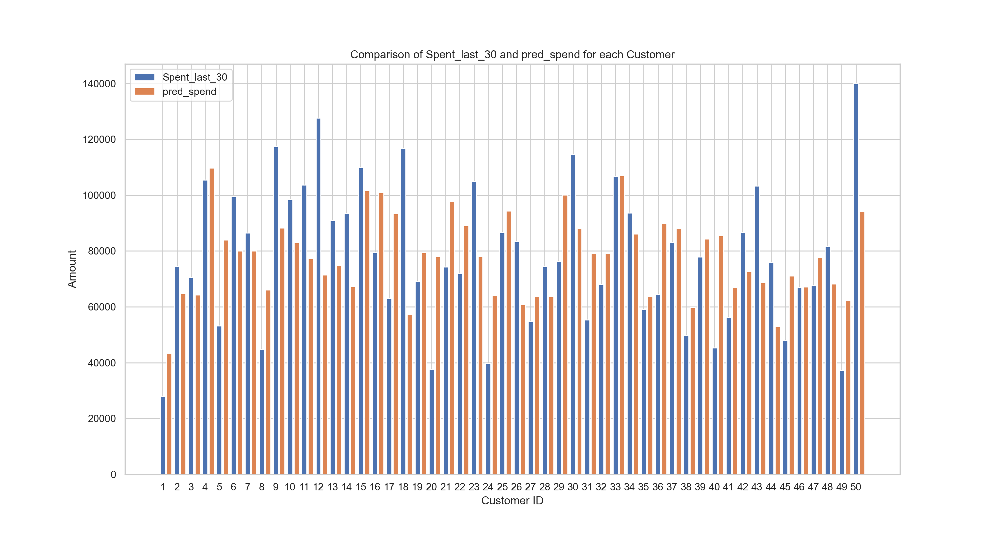

In [110]:
predictions_df5['_CustomerID1'] = predictions_df5['_CustomerID'].astype(int)

# Sort the DataFrame by '_CustomerID'
predictions_df5 = predictions_df5.sort_values('_CustomerID1')

# Set the style for better visualization
sns.set(style="whitegrid")

# Create a bar chart
plt.figure(figsize=(15, 8))
bar_width = 0.35
bar_spacing = 0.1 # Set the desired spacing between bars

# Set x-axis ticks to the sorted values of '_CustomerID'
plt.xticks(range(len(predictions_df5['_CustomerID'])), predictions_df5['_CustomerID'])

# Plot the 'Spent_last_30' on the x-axis with adjusted x-coordinates for spacing
plt.bar(range(len(predictions_df5['_CustomerID'])), predictions_df5['Spent_last_30'], bar_width, label='Spent_last_30')

# Plot the 'pred_spend' on the x-axis with adjusted x-coordinates for spacing
plt.bar([i + (bar_width + bar_spacing) for i in range(len(predictions_df5['_CustomerID1']))], predictions_df5['pred_spend'], bar_width, label='pred_spend')

# Set labels and title
plt.xlabel('Customer ID')
plt.ylabel('Amount')
plt.title('Comparison of Spent_last_30 and pred_spend for each Customer')
plt.legend()

# Show the plot
plt.show()

In [111]:
y_spend6 = features_df1['Spent_last_30']

# Creating the Linear Regression model
ols_model = LinearRegression()

# Performing cross-validated predictions
predicted_values = cross_val_predict(ols_model, X, y_spend6, cv=5)

# Displaying the predicted values
print('Predicted Values:')
print(predicted_values)

Predicted Values:
[ 33500.22914879  89970.17311289  89787.45325414  74247.74116879
  81964.96118996  83165.02221696 113765.17324606  89528.74319608
  80526.84371104  75699.3547675   86625.13355105  60755.74026779
  60487.45229005  85572.80998254  97142.48887036 102848.81702796
  60426.72654232 113474.58732888  70090.9103268   54269.49641991
  57230.48194538  52985.12154958  52994.86272471 112784.32707865
  59722.24768842  62355.71924322 105799.36279361  89388.00613807
  71517.06306989  62238.46450155  78376.92345983  61799.83451355
  83183.93726365 110663.03466618  84498.87889108  69666.44185871
  72186.89077218  97234.69112402  69084.84323466  46980.40590762
  62231.16521004  78157.78023818  47245.66963898  58105.59200129
  67200.66639856 125773.36696779  99073.7124714   92955.00800751
  53082.69000312  94622.29930767]


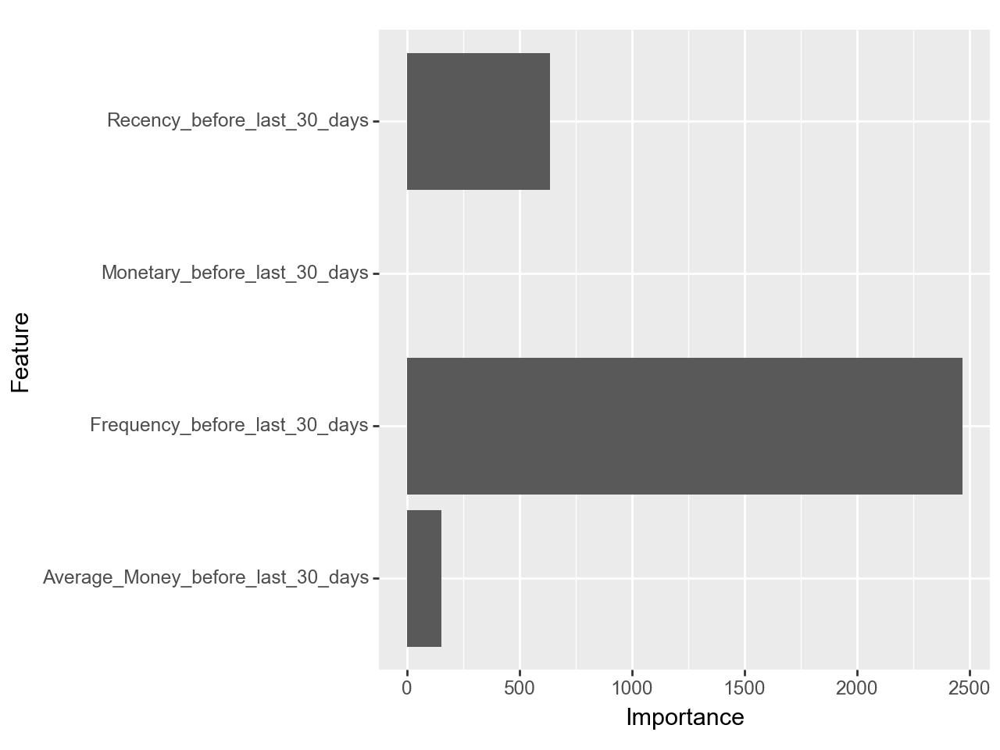

In [112]:
# Fitting the model
ols_model.fit(X, y_spend6)

# Extract feature importances (coefficients)
feature_importances10 = ols_model.coef_

# Take the absolute values of feature importances
abs_feature_importances10 = abs(feature_importances10)

# Create a DataFrame to store feature names and their corresponding importance values
feature_importance_df10 = pd.DataFrame({
    'Feature': X.columns,
    'Importance': abs_feature_importances10
}).sort_values(by='Importance', ascending=False)

# Create a ggplot visualization using Plotnine
plot = (
    ggplot(feature_importance_df10, aes(x='Feature', y='Importance'))
    + geom_col()
    + coord_flip()
)

# Display the plot
plot.draw()

In [113]:
# Extract feature importances (coefficients)
feature_importances = ols_model.coef_

# Displaying the feature importances
print('Feature Importances:')
for feature, importance in zip(X.columns, feature_importances):
    print(f'{feature}: {importance}')

Feature Importances:
Recency_before_last_30_days: -636.3260865393503
Frequency_before_last_30_days: 2468.328130788173
Monetary_before_last_30_days: -0.8615821484654589
Average_Money_before_last_30_days: 153.52900860898598


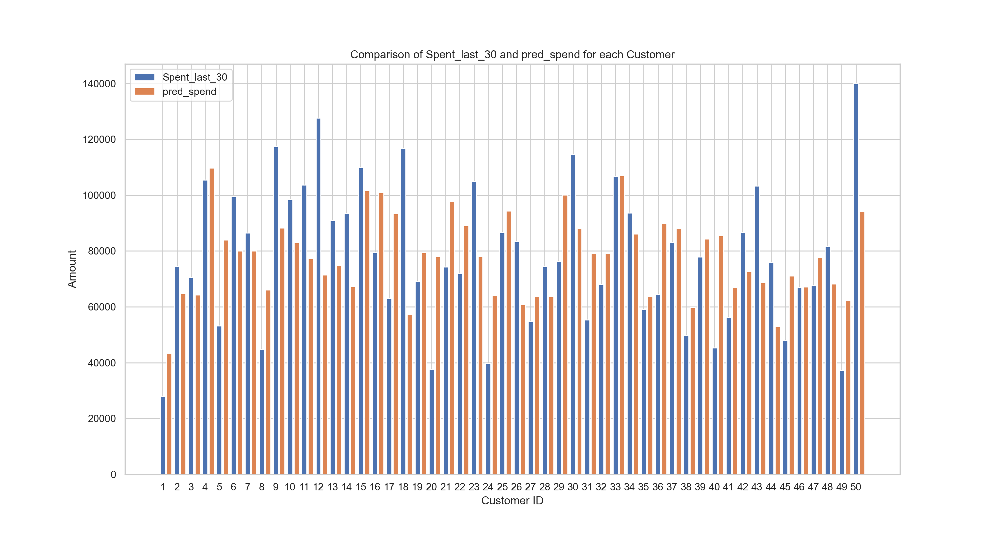

In [114]:
predictions_df5['_CustomerID1'] = predictions_df5['_CustomerID'].astype(int)

# Sort the DataFrame by '_CustomerID'
predictions_df5 = predictions_df5.sort_values('_CustomerID1')

# Set the style for better visualization
sns.set(style="whitegrid")

# Create a bar chart
plt.figure(figsize=(15, 8))
bar_width = 0.35
bar_spacing = 0.1 # Set the desired spacing between bars

# Set x-axis ticks to the sorted values of '_CustomerID'
plt.xticks(range(len(predictions_df5['_CustomerID'])), predictions_df5['_CustomerID'])

# Plot the 'Spent_last_30' on the x-axis with adjusted x-coordinates for spacing
plt.bar(range(len(predictions_df5['_CustomerID'])), predictions_df5['Spent_last_30'], bar_width, label='Spent_last_30')

# Plot the 'pred_spend' on the x-axis with adjusted x-coordinates for spacing
plt.bar([i + (bar_width + bar_spacing) for i in range(len(predictions_df5['_CustomerID1']))], predictions_df5['pred_spend'], bar_width, label='pred_spend')

# Set labels and title
plt.xlabel('Customer ID')
plt.ylabel('Amount')
plt.title('Comparison of Spent_last_30 and pred_spend for each Customer')
plt.legend()

# Show the plot
plt.show()